# Network insights: Walkability and Hierarchical Clustering of London Diverse Urban Services(Code)

In [1]:
!pip install PyPDF2
!pip install psd-tools

In [2]:
import requests
import zipfile
import os
import geopandas as gpd
import pandas as pd
import networkx as nx
from shapely.geometry import Point, MultiPolygon
import osmnx as ox
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import PyPDF2
import re
import io
from psd_tools import PSDImage
from scipy.stats import mode
import shutil
from shapely.ops import unary_union, split
import math
from matplotlib.colors import ListedColormap

In [3]:
import time
start_time =time.time()

# 1 Introduction

# 2 Literature

# 3 Methodology

## 3.1 Data

### 3.1.1 Administrate District

In [4]:
r = requests.get("https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/b592099ae267eb80d501df974974751c3170a8ad/3.1%20Data/Administrate%20District/London%20Boundary.zip")
z = zipfile.ZipFile(io.BytesIO(r.content))
z.extractall("LondonBoundary")

LondonBoundary = gpd.read_file("LondonBoundary/London Boundary.shp")
LondonBoundary

,NAME,Area,geometry
0,London,1573.400741,"POLYGON ((531643.600 200802.700, 531658.600 20..."


In [5]:
StatisticResponse = requests.get("https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/0b8434f7b1b8b8164d97af8faf1d40a2e8c91bf8/3.1%20Data/Administrate%20District/statistical-gis-boundaries-london.zip")

if StatisticResponse.status_code == 200:
    try:
        zip_file = zipfile.ZipFile(io.BytesIO(StatisticResponse.content))
        zip_file.extractall("statistical-gis-boundaries-london")
        print("ZIP downloaded and unziped。")
    except zipfile.BadZipFile:
        print("Not a zip file")
else:
    print(f"Fail：{StatisticResponse.status_code}")

ZIP 文件下载并解压成功。


#### 3.1.1.1 OA

In [6]:
OA = gpd.read_file("statistical-gis-boundaries-london/statistical-gis-boundaries-london/ESRI/OA_2011_London_gen_MHW.shp")
OA

,OA11CD,LSOA11CD,MSOA11CD,WD11CD_BF,WD11NM_BF,LAD11CD,LAD11NM,RGN11CD,RGN11NM,LSOA11NM,MSOA11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E00023264,E01004612,E02000954,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 032C,Wandsworth 032,462,459,3,115.2,143,3.2,"POLYGON ((527635.452 171810.058, 527495.957 17..."
1,E00003359,E01000692,E02000128,E05000111,Chislehurst,E09000006,Bromley,E12000007,London,Bromley 002D,Bromley 002,269,259,10,36.7,133,1.9,"POLYGON ((543581.516 171132.486, 543704.000 17..."
2,E00023266,E01004615,E02000956,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 034B,Wandsworth 034,277,277,0,183.4,133,2.1,"POLYGON ((526613.539 171839.165, 526546.840 17..."
3,E00020264,E01004027,E02000809,E05000548,Riverside,E09000028,Southwark,E12000007,London,Southwark 003E,Southwark 003,415,415,0,96.1,191,2.2,"POLYGON ((533563.521 179695.146, 533351.118 17..."
4,E00023263,E01004613,E02000955,E05000626,Tooting,E09000032,Wandsworth,E12000007,London,Wandsworth 033D,Wandsworth 033,304,304,0,165.2,131,2.3,"POLYGON ((527822.000 172020.000, 527979.000 17..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25048,E00004047,E01000828,E02000137,E05000126,Shortlands,E09000006,Bromley,E12000007,London,Bromley 011E,Bromley 011,349,349,0,43.7,117,3.0,"POLYGON ((539163.316 168360.071, 539026.000 16..."
25049,E00007044,E01001420,E02000296,E05000196,Cockfosters,E09000010,Enfield,E12000007,London,Enfield 020B,Enfield 020,288,288,0,30.5,114,2.5,"POLYGON ((528811.000 195161.000, 528814.206 19..."
25050,E00003854,E01000791,E02000155,E05000122,Orpington,E09000006,Bromley,E12000007,London,Bromley 029E,Bromley 029,284,284,0,32.1,126,2.3,"POLYGON ((546965.963 166027.878, 546947.923 16..."
25051,E00014344,E01002862,E02000590,E05000390,Hans Town,E09000020,Kensington and Chelsea,E12000007,London,Kensington and Chelsea 014E,Kensington and Chelsea 014,452,452,0,22600.0,384,1.2,"POLYGON ((527325.087 178641.434, 527321.728 17..."


#### 3.1.1.2 LSOA

In [7]:
LSOA = gpd.read_file("statistical-gis-boundaries-london/statistical-gis-boundaries-london/ESRI/LSOA_2011_London_gen_MHW.shp")
LSOA

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,0,112.9,876,1.7,"POLYGON ((532105.092 182011.230, 532162.491 18..."
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,0,62.9,830,1.7,"POLYGON ((532746.813 181786.891, 532671.688 18..."
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,96,227.7,817,1.5,"POLYGON ((532135.145 182198.119, 532158.250 18..."
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,0,52.0,467,2.1,"POLYGON ((533807.946 180767.770, 533649.063 18..."
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,4,116.2,543,3.1,"POLYGON ((545122.049 184314.931, 545271.917 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1352,1352,0,107.6,581,2.3,"POLYGON ((544642.680 179824.674, 544766.313 17..."
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,0,20.4,663,3.1,"POLYGON ((546579.195 181097.813, 546687.036 18..."
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,117,125.8,646,2.7,"POLYGON ((544536.486 179447.115, 544602.630 17..."
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1820,1820,0,32.3,591,3.1,"POLYGON ((546415.745 180152.270, 546320.715 18..."


#### 3.1.1.3 MSOA

In [8]:
MSOA = gpd.read_file("statistical-gis-boundaries-london/statistical-gis-boundaries-london/ESRI/MSOA_2011_London_gen_MHW.shp")
MSOA

,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E02000001,City of London 001,E09000001,City of London,E12000007,London,7375,7187,188,25.5,4385,1.6,"MULTIPOLYGON (((531667.624 180534.992, 531647...."
1,E02000002,Barking and Dagenham 001,E09000002,Barking and Dagenham,E12000007,London,6775,6724,51,31.3,2713,2.5,"POLYGON ((548881.563 190845.265, 548881.125 19..."
2,E02000003,Barking and Dagenham 002,E09000002,Barking and Dagenham,E12000007,London,10045,10033,12,46.9,3834,2.6,"POLYGON ((549102.438 189324.625, 548954.500 18..."
3,E02000004,Barking and Dagenham 003,E09000002,Barking and Dagenham,E12000007,London,6182,5937,245,24.8,2318,2.6,"POLYGON ((551549.998 187364.637, 551478.000 18..."
4,E02000005,Barking and Dagenham 004,E09000002,Barking and Dagenham,E12000007,London,8562,8562,0,72.1,3183,2.7,"POLYGON ((549099.634 187656.076, 549161.375 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
978,E02006927,Greenwich 034,E09000011,Greenwich,E12000007,London,8315,8241,74,33.0,3338,2.5,"POLYGON ((541029.881 176265.023, 541101.997 17..."
979,E02006928,Greenwich 035,E09000011,Greenwich,E12000007,London,7341,6410,931,136.0,2977,2.2,"MULTIPOLYGON (((538300.370 177956.632, 538290...."
980,E02006929,Greenwich 036,E09000011,Greenwich,E12000007,London,7490,7489,1,29.4,3333,2.2,"POLYGON ((540054.366 179353.136, 540220.352 17..."
981,E02006930,Greenwich 037,E09000011,Greenwich,E12000007,London,6561,6557,4,75.6,2876,2.3,"POLYGON ((539552.478 178604.042, 539533.000 17..."


#### 3.1.1.4 Borough

In [9]:
Borough = gpd.read_file("statistical-gis-boundaries-london/statistical-gis-boundaries-london/ESRI/London_Borough_Excluding_MHW.shp")
Borough

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry
0,Kingston upon Thames,E09000021,3726.117,0.000,F,NaN,NaN,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Croydon,E09000008,8649.441,0.000,F,NaN,NaN,"POLYGON ((535009.200 159504.700, 535005.500 15..."
2,Bromley,E09000006,15013.487,0.000,F,NaN,NaN,"POLYGON ((540373.600 157530.400, 540361.200 15..."
3,Hounslow,E09000018,5658.541,60.755,F,NaN,NaN,"POLYGON ((521975.800 178100.000, 521967.700 17..."
4,Ealing,E09000009,5554.428,0.000,F,NaN,NaN,"POLYGON ((510253.500 182881.600, 510249.900 18..."
5,Havering,E09000016,11445.735,210.763,F,NaN,NaN,"POLYGON ((549893.900 181459.800, 549894.600 18..."
6,Hillingdon,E09000017,11570.063,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510615.200 19..."
7,Harrow,E09000015,5046.330,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510660.000 19..."
8,Brent,E09000005,4323.270,0.000,F,NaN,NaN,"POLYGON ((525201.000 182512.600, 525181.500 18..."
9,Barnet,E09000003,8674.837,0.000,F,NaN,NaN,"POLYGON ((524579.900 198355.200, 524594.300 19..."


#### 3.1.1.5 Borough - MSOA - LSOA- OA Hierarchy

In [10]:
MSOA_counts = OA.groupby('LAD11CD')['MSOA11CD'].nunique().reset_index(name='MSOA_Counts')
LSOA_counts = OA.groupby('LAD11CD')['LSOA11CD'].nunique().reset_index(name='LSOA_Counts')
OA_counts = OA.groupby('LAD11CD')['OA11CD'].nunique().reset_index(name='OA_Counts')

OA_LSOA_MSOA = MSOA_counts.merge(LSOA_counts, on='LAD11CD').merge(OA_counts, on='LAD11CD')

OA_LSOA_MSOA_Borough = pd.merge(OA_LSOA_MSOA, Borough[['GSS_CODE', 'NAME']], left_on='LAD11CD', right_on='GSS_CODE', how='right')
OA_LSOA_MSOA_Borough.drop(columns=['GSS_CODE'], inplace=True)
OA_LSOA_MSOA_Borough = OA_LSOA_MSOA_Borough.sort_values(by=['MSOA_Counts', 'LSOA_Counts', 'OA_Counts'], ascending=False)
OA_LSOA_MSOA_Borough

,LAD11CD,MSOA_Counts,LSOA_Counts,OA_Counts,NAME
1,E09000008,44,220,1132,Croydon
9,E09000003,41,211,1036,Barnet
2,E09000006,39,197,1020,Bromley
4,E09000009,39,196,956,Ealing
21,E09000032,37,179,982,Wandsworth
30,E09000025,37,164,810,Newham
15,E09000010,36,183,905,Enfield
12,E09000023,36,169,887,Lewisham
29,E09000014,36,145,753,Haringey
10,E09000022,35,178,966,Lambeth


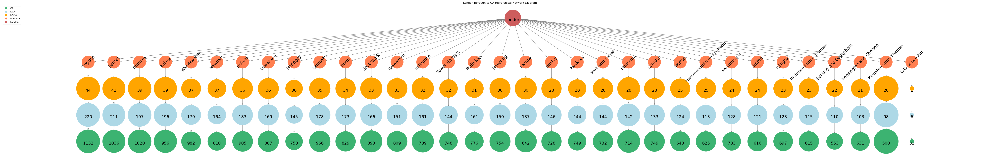

In [11]:
G = nx.DiGraph()

for idx, row in OA_LSOA_MSOA_Borough.iterrows():
    oa_node = f"OA_{idx}_{row['OA_Counts']}"
    lsoa_node = f"LSOA_{idx}_{row['LSOA_Counts']}"
    msoa_node = f"MSOA_{idx}_{row['MSOA_Counts']}"
    
    G.add_edge("London", row['NAME']) 
    G.add_edge(row['NAME'], msoa_node) 
    G.add_edge(msoa_node, lsoa_node)
    G.add_edge(lsoa_node, oa_node) 


oa_sizes = OA_LSOA_MSOA_Borough['OA_Counts'].values
scaling_factor = 10 
node_size = []

for node in G.nodes():
    if node.startswith(('OA_', 'LSOA_', 'MSOA_', 'LAD_')):
        idx = int(node.split('_')[1])
        size = oa_sizes[idx] * scaling_factor
        node_size.append(size)
    else:
        node_size.append(3000 if node != 'London' else 5000) 
        
arrowsize = 10


layer_colors = {"OA": "mediumseagreen", "LSOA": "lightblue", "MSOA": "orange", "Borough": "coral", "London": "indianred"}


node_color = []
for node in G.nodes():
    if node.startswith('OA_'):
        node_color.append(layer_colors["OA"])
    elif node.startswith('LSOA_'):
        node_color.append(layer_colors["LSOA"])
    elif node.startswith('MSOA_'):
        node_color.append(layer_colors["MSOA"])
    elif node == "London":
        node_color.append(layer_colors["London"])
    else:
        node_color.append(layer_colors["Borough"])


layers = [
    ["London"],  # 第一层
    [node for node in G.nodes() if not node.startswith(('OA_', 'LSOA_', 'MSOA_')) and node != "London"],  # 第二层 (Borough NAME)
    sorted([node for node in G.nodes() if node.startswith('MSOA_')], key=lambda x: int(x.split('_')[-1]), reverse=True),  # 第三层 (MSOA_Counts) 按从大到小排序
    [node for node in G.nodes() if node.startswith('LSOA_')],  # 第四层 (LSOA_Counts) 与上一层顺序保持一致
    [node for node in G.nodes() if node.startswith('OA_')]  # 第五层 (OA_Counts) 与上一层顺序保持一致
]

pos = {}
for i, layer in enumerate(layers):
    for j, node in enumerate(layer):
        pos[node] = (j, -i * 1.5) 
        
pos["London"] = (len(layers[1]) / 2, 1)


plt.figure(figsize=(60, 9))
nx.draw(G, pos, with_labels=False, node_size=node_size, node_color=node_color, font_size=10, font_weight='bold',
        edge_color='gray', verticalalignment='top', arrows=True, arrowstyle='-|>', arrowsize=arrowsize,
        bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.3'))


labels = {}
for node in G.nodes():
    if 'OA_' in node or 'LSOA_' in node or 'MSOA_' in node:
        labels[node] = node.split('_')[-1]
    else:
        labels[node] = node

text_items = nx.draw_networkx_labels(G, pos, labels=labels, font_size=18, verticalalignment='top')

for node, t in text_items.items():
    if node in layers[1]: 
        t.set_rotation(45)
        t.set_horizontalalignment('center') 
        t.set_verticalalignment('center')  
        

plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', label='OA', markersize=10, markerfacecolor='mediumseagreen'),
                    plt.Line2D([0], [0], marker='o', color='w', label='LSOA', markersize=10, markerfacecolor='lightblue'),
                    plt.Line2D([0], [0], marker='o', color='w', label='MSOA', markersize=10, markerfacecolor='orange'),
                    plt.Line2D([0], [0], marker='o', color='w', label='Borough', markersize=10, markerfacecolor='coral'),
                    plt.Line2D([0], [0], marker='o', color='w', label='London', markersize=10, markerfacecolor='indianred')],
           loc='upper left')

plt.title("London Borough to OA Hierarchical Network Diagram")
plt.savefig('10-3 Study Area and Data/London Borough to OA Hierarchical Network Diagram.png', dpi=300, bbox_inches='tight')  # 调整分辨率和边界
plt.show()

### 3.1.2 Service POl

In [12]:
OIurl = "https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/0a733721489cab37842afb77f4cf9f464580eaf8/3.1%20Data/Reclassfied%20London%20Service%20POI.zip"
POIzip_path = "Reclassfied_London_Service_POI.zip"

POIresponse = requests.get(POIurl, stream=True)
POIresponse.raise_for_status()
with open(POIzip_path, 'wb') as file:
    file.write(POIresponse.content)

with zipfile.ZipFile(POIzip_path, 'r') as zip_ref:
    zip_ref.extractall("shapefiles")

shp_files = [f for f in os.listdir("shapefiles") if f.endswith('.shp')]

POIgdfs = {os.path.splitext(f)[0]: gpd.read_file(os.path.join("shapefiles", f)) for f in shp_files}

for name, gdf in POIgdfs.items():
    print(f"Info for GeoDataFrame: {name}")
    gdf.info()
    print("\n")

Info for GeoDataFrame: DPS
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 10551 entries, 0 to 10550
Data columns (total 31 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ref_no      10551 non-null  int64   
 1   name        10551 non-null  object  
 2   pointx_cla  10551 non-null  object  
 3   groupname   10551 non-null  object  
 4   categoryna  10551 non-null  object  
 5   classname   10551 non-null  object  
 6   feature_ea  10551 non-null  float64 
 7   feature_no  10551 non-null  float64 
 8   pos_accura  10551 non-null  int64   
 9   uprn        9730 non-null   object  
 10  topo_toid   10551 non-null  object  
 11  topo_toid_  10551 non-null  int64   
 12  usrn        10551 non-null  object  
 13  usrn_mi     10551 non-null  int64   
 14  distance    10551 non-null  float64 
 15  address_de  10347 non-null  object  
 16  street_nam  10329 non-null  object  
 17  locality    10550 non-null  object  
 18  geographic 

In [13]:
total_rows = 0

for name, gdf in POIgdfs.items():
    row_count = len(gdf)
    total_rows += row_count
    print(f"London is served by {row_count} {name} POIs.")

print(f"London is served by {total_rows} POIs as a total")

London is served by 10551 DPS POIs.
London is served by 53928 DS POIs.
London is served by 5801 EdS POIs.
London is served by 29550 EnF POIs.
London is served by 12294 FS POIs.
London is served by 11144 HouS POIs.
London is served by 10273 HS POIs.
London is served by 996 PCS POIs.
London is served by 10687 RS POIs.
London is served by 30814 TLS POIs.
London is served by 176038 POIs as a total


#### 3.1.2.1 LSOA Level POI Count

In [14]:
LSOA_counts = LSOA.copy() 

for name, gdf in POIgdfs.items():
    if name != 'LSOA':
        
        joined_gdf = gpd.sjoin(gdf, LSOA_counts, how='inner', op='within')
        
        counts = joined_gdf.groupby('LSOA11CD').size() 
        
        LSOA_counts[name + '_count'] = LSOA_counts['LSOA11CD'].map(counts).fillna(0)

last_ten_columns = LSOA_counts.columns[-10:]
LSOA_counts['POI_count'] = LSOA_counts[last_ten_columns].sum(axis=1)
LSOA_counts

/opt/conda/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/tmp/ipykernel_20453/2036059538.py:8: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  joined_gdf = gpd.sjoin(gdf, LSOA_counts, how='inner', op='within')
/opt/conda/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/tmp/ipykernel_20453/2036059538.py:8: UserWarning: CRS mismatch between the CRS of left geo

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,DS_count,EdS_count,EnF_count,FS_count,HouS_count,HS_count,PCS_count,RS_count,TLS_count,POI_count
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,...,21.0,0.0,40.0,5.0,3.0,6.0,0.0,1.0,15.0,95.0
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,...,30.0,2.0,43.0,17.0,3.0,8.0,0.0,4.0,12.0,135.0
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,...,9.0,1.0,11.0,2.0,2.0,3.0,0.0,0.0,1.0,31.0
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,...,88.0,0.0,27.0,7.0,6.0,6.0,0.0,5.0,22.0,174.0
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1352,1352,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,...,3.0,0.0,5.0,4.0,3.0,1.0,1.0,5.0,4.0,30.0
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,...,4.0,0.0,1.0,2.0,0.0,4.0,0.0,0.0,4.0,15.0
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1820,1820,...,1.0,3.0,1.0,0.0,1.0,3.0,0.0,0.0,9.0,23.0


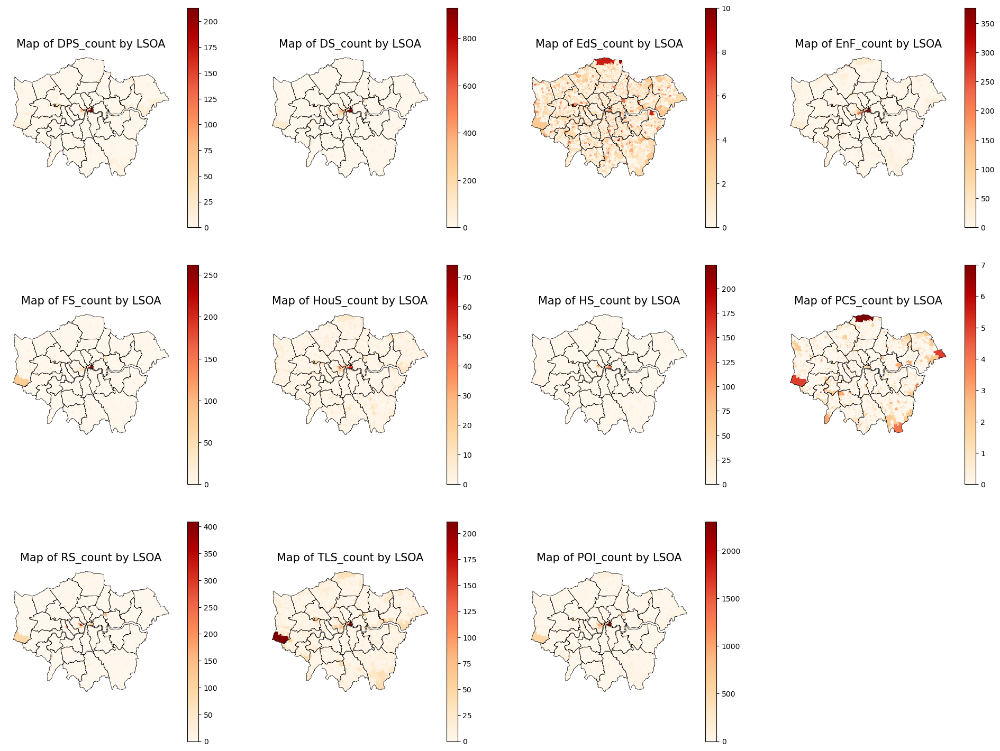

In [15]:
last_eleven_columns = LSOA_counts.columns[-11:]

fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 15))

fig.tight_layout(pad=3.0)

axes = axes.flatten()

for i, column in enumerate(last_eleven_columns):
    LSOA_counts.plot(column=column, ax=axes[i], legend=True, cmap='OrRd', edgecolor='none')
    Borough.boundary.plot(ax=axes[i], linewidth=0.5, color='black')
    axes[i].set_title(f"Map of {column} by LSOA", fontsize=15)
    axes[i].set_axis_off()

for j in range(len(last_eleven_columns), len(axes)):
    fig.delaxes(axes[j])

plt.show()

In [16]:
last_eleven_columns = LSOA_counts.columns[-11:]

results = {}

for column in last_eleven_columns:
    max_value = LSOA_counts[column].max()
    min_value = LSOA_counts[column].min()
    
    mode_result = mode(LSOA_counts[column], nan_policy='omit')
    
    if isinstance(mode_result.count, np.ndarray) and mode_result.count.size > 0:
        mode_value = mode_result.mode[0]
        mode_count = mode_result.count[0]
    else:
        mode_value = 0
        mode_count = 0
    
    max_rows = LSOA_counts[LSOA_counts[column] == max_value]
    min_rows = LSOA_counts[LSOA_counts[column] == min_value]
    
    max_count = max_rows.shape[0]
    min_count = min_rows.shape[0]
    
    results[column] = {
        'max_value': max_value,
        'max_count': max_count,
        'min_value': min_value,
        'min_count': min_count,
        'mode_value': mode_value,
        'mode_count': mode_count
    }

    if max_count < 5:
        results[column]['max_info'] = [
            {
                'LSOA11NM': row['LSOA11NM'],
                'MSOA11NM': row['MSOA11NM'],
                'LAD11NM': row['LAD11NM']
            } for _, row in max_rows.iterrows()
        ]
    
    if min_count < 5:
        results[column]['min_info'] = [
            {
                'LSOA11NM': row['LSOA11NM'],
                'MSOA11NM': row['MSOA11NM'],
                'LAD11NM': row['LAD11NM']
            } for _, row in min_rows.iterrows()
        ]


for column, result in results.items():
    print(f"Column: {column}")
    
    print(f"  Max Value: {result['max_value']} (Number of rows: {result['max_count']})")
    if result['max_count'] < 5:
        for info in result.get('max_info', []):
            print(f"    (LSOA11NM: {info['LSOA11NM']}, MSOA11NM: {info['MSOA11NM']}, LAD11NM: {info['LAD11NM']})")
    
    print(f"  Min Value: {result['min_value']} (Number of rows: {result['min_count']})")
    if result['min_count'] < 5:
        for info in result.get('min_info', []):
            print(f"    (LSOA11NM: {info['LSOA11NM']}, MSOA11NM: {info['MSOA11NM']}, LAD11NM: {info['LAD11NM']})")
    
    if result['mode_value'] == 0:
        print(f"  Mode Value: 0")
    else:
        print(f"  Mode Value: {result['mode_value']} (Number of rows: {result['mode_count']})")
    
    print("\n")

Column: DPS_count
  Max Value: 213.0 (Number of rows: 1)
    (LSOA11NM: City of London 001F, MSOA11NM: City of London 001, LAD11NM: City of London)
  Min Value: 0.0 (Number of rows: 1875)
  Mode Value: 0


Column: DS_count
  Max Value: 928.0 (Number of rows: 1)
    (LSOA11NM: City of London 001F, MSOA11NM: City of London 001, LAD11NM: City of London)
  Min Value: 0.0 (Number of rows: 1096)
  Mode Value: 0


Column: EdS_count
  Max Value: 10.0 (Number of rows: 1)
    (LSOA11NM: Croydon 027B, MSOA11NM: Croydon 027, LAD11NM: Croydon)
  Min Value: 0.0 (Number of rows: 1804)
  Mode Value: 0


Column: EnF_count
  Max Value: 376.0 (Number of rows: 1)
    (LSOA11NM: City of London 001F, MSOA11NM: City of London 001, LAD11NM: City of London)
  Min Value: 0.0 (Number of rows: 403)
  Mode Value: 0


Column: FS_count
  Max Value: 262.0 (Number of rows: 1)
    (LSOA11NM: City of London 001F, MSOA11NM: City of London 001, LAD11NM: City of London)
  Min Value: 0.0 (Number of rows: 1968)
  Mode Value:

In [17]:
selected_columns_sums = LSOA_counts.iloc[:, 15:25].sum()
total_sum_columns_16_to_25 = LSOA_counts.iloc[:, 15:25].values.sum()

for column_name, column_sum in selected_columns_sums.items():
    print(f"The sum of {column_name} is: {column_sum}")

print(f"The total sum of service POI within in LSOA_counts is: {total_sum_columns_16_to_25}")

The sum of DPS_count is: 10241.0
The sum of DS_count is: 53008.0
The sum of EdS_count is: 5627.0
The sum of EnF_count is: 28394.0
The sum of FS_count is: 12017.0
The sum of HouS_count is: 10750.0
The sum of HS_count is: 10022.0
The sum of PCS_count is: 940.0
The sum of RS_count is: 10546.0
The sum of TLS_count is: 29026.0
The total sum of service POI within in LSOA_counts is: 170571.0


#### 3.1.2.2 Borough Level POI Count

In [18]:
Borough_counts = Borough.copy() 

for name, gdf in POIgdfs.items():
    if name != 'NAME':
        joined_gdf = gpd.sjoin(gdf, Borough_counts, how='inner', op='within')
        counts = joined_gdf.groupby('NAME').size()  # 假设 'LSOA11CD' 是 LSOA 的唯一标识符
        Borough_counts[name + '_count'] = Borough_counts['NAME'].map(counts).fillna(0)

last_ten_columns = Borough_counts.columns[-10:]
Borough_counts['POI_count'] = Borough_counts[last_ten_columns].sum(axis=1)
Borough_counts

/opt/conda/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/tmp/ipykernel_20453/2254045242.py:8: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  joined_gdf = gpd.sjoin(gdf, Borough_counts, how='inner', op='within')
/opt/conda/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/tmp/ipykernel_20453/2254045242.py:8: UserWarning: CRS mismatch between the CRS of left 

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry,DPS_count,DS_count,EdS_count,EnF_count,FS_count,HouS_count,HS_count,PCS_count,RS_count,TLS_count,POI_count
0,Kingston upon Thames,E09000021,3726.117,0.000,F,NaN,NaN,"POLYGON ((516401.600 160201.800, 516407.300 16...",180,864,111,505,200,212,208,31,229,612,3152
1,Croydon,E09000008,8649.441,0.000,F,NaN,NaN,"POLYGON ((535009.200 159504.700, 535005.500 15...",387,1840,287,931,474,525,349,56,213,1412,6474
2,Bromley,E09000006,15013.487,0.000,F,NaN,NaN,"POLYGON ((540373.600 157530.400, 540361.200 15...",336,1456,232,1128,350,501,370,65,282,1559,6279
3,Hounslow,E09000018,5658.541,60.755,F,NaN,NaN,"POLYGON ((521975.800 178100.000, 521967.700 17...",313,1177,158,813,395,267,257,31,159,1121,4691
4,Ealing,E09000009,5554.428,0.000,F,NaN,NaN,"POLYGON ((510253.500 182881.600, 510249.900 18...",415,1774,217,958,466,393,378,28,286,1154,6069
5,Havering,E09000016,11445.735,210.763,F,NaN,NaN,"POLYGON ((549893.900 181459.800, 549894.600 18...",285,1106,188,638,299,412,251,56,201,1008,4444
6,Hillingdon,E09000017,11570.063,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510615.200 19...",308,1300,196,897,477,375,298,45,283,1380,5559
7,Harrow,E09000015,5046.330,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510660.000 19...",278,1081,152,646,257,293,270,16,158,687,3838
8,Brent,E09000005,4323.270,0.000,F,NaN,NaN,"POLYGON ((525201.000 182512.600, 525181.500 18...",376,1775,191,734,445,284,319,14,270,990,5398
9,Barnet,E09000003,8674.837,0.000,F,NaN,NaN,"POLYGON ((524579.900 198355.200, 524594.300 19...",407,1736,253,1102,407,546,487,50,353,1456,6797


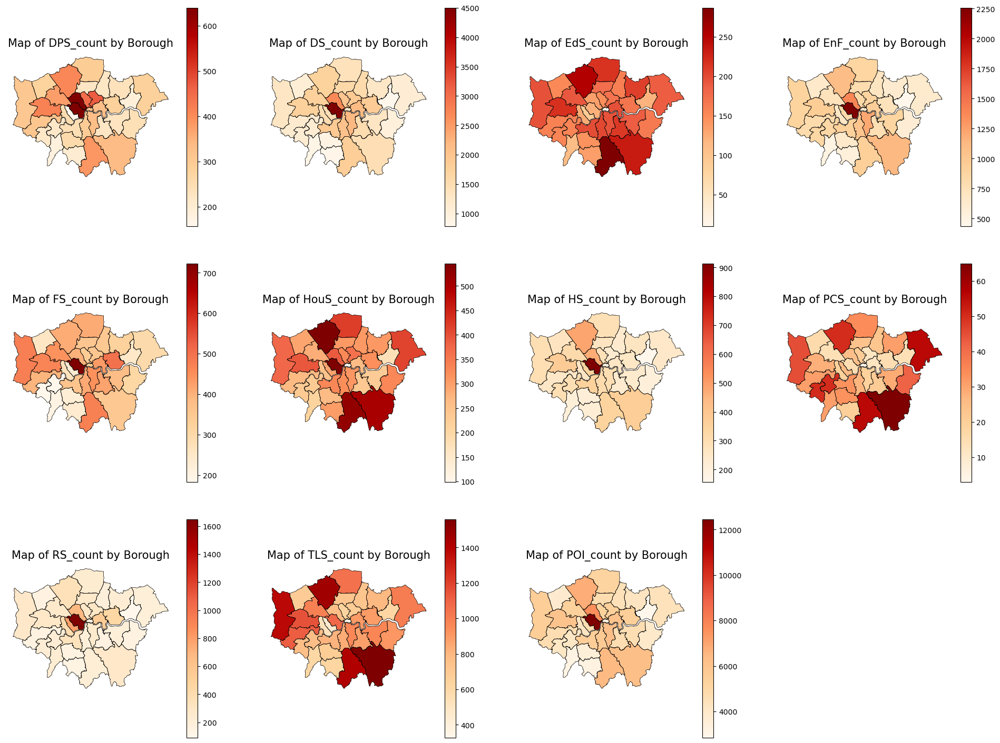

In [19]:
last_eleven_columns = Borough_counts.columns[-11:]


fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 15))
fig.tight_layout(pad=3.0)

axes = axes.flatten()

for i, column in enumerate(last_eleven_columns):
    Borough_counts.plot(column=column, ax=axes[i], legend=True, cmap='OrRd', edgecolor='none')
    Borough.boundary.plot(ax=axes[i], linewidth=0.5, color='black')
    axes[i].set_title(f"Map of {column} by Borough", fontsize=15)
    axes[i].set_axis_off()

for j in range(len(last_eleven_columns), len(axes)):
    fig.delaxes(axes[j])

plt.show()

In [20]:
last_eleven_columns = Borough_counts.columns[-11:]

results = {}

for column in last_eleven_columns:
    max_value = Borough_counts[column].max()
    min_value = Borough_counts[column].min()

    max_rows = Borough_counts[Borough_counts[column] == max_value]
    min_rows = Borough_counts[Borough_counts[column] == min_value]
    
    max_count = max_rows.shape[0]
    min_count = min_rows.shape[0]
    
    results[column] = {
        'max_value': max_value,
        'max_count': max_count,
        'min_value': min_value,
        'min_count': min_count,
    }

    if max_count < 5:
        results[column]['max_info'] = [
            { 'NAME': row['NAME'],} 
            for _, row in max_rows.iterrows()
        ]
    
    if min_count < 5:
        results[column]['min_info'] = [
             { 'NAME': row['NAME'],} 
            for _, row in min_rows.iterrows()
        ]

for column, result in results.items():
    print(f"Column: {column}")
    
    print(f"  Max Value: {result['max_value']} (Number of rows: {result['max_count']})")
    if result['max_count'] < 5:
        for info in result.get('max_info', []):
            print(f"    (LAD11NM: {info['NAME']})")
    
    print(f"  Min Value: {result['min_value']} (Number of rows: {result['min_count']})")
    if result['min_count'] < 5:
        for info in result.get('min_info', []):
            print(f"    (LAD11NM: {info['NAME']})")
    
    print("\n")

Column: DPS_count
  Max Value: 640 (Number of rows: 2)
    (LAD11NM: Westminster)
    (LAD11NM: Camden)
  Min Value: 157 (Number of rows: 1)
    (LAD11NM: Kensington and Chelsea)


Column: DS_count
  Max Value: 4502 (Number of rows: 1)
    (LAD11NM: Westminster)
  Min Value: 787 (Number of rows: 1)
    (LAD11NM: Barking and Dagenham)


Column: EdS_count
  Max Value: 287 (Number of rows: 1)
    (LAD11NM: Croydon)
  Min Value: 10 (Number of rows: 1)
    (LAD11NM: City of London)


Column: EnF_count
  Max Value: 2258 (Number of rows: 1)
    (LAD11NM: Westminster)
  Min Value: 437 (Number of rows: 1)
    (LAD11NM: Barking and Dagenham)


Column: FS_count
  Max Value: 723 (Number of rows: 1)
    (LAD11NM: Westminster)
  Min Value: 183 (Number of rows: 1)
    (LAD11NM: Richmond upon Thames)


Column: HouS_count
  Max Value: 546 (Number of rows: 1)
    (LAD11NM: Barnet)
  Min Value: 99 (Number of rows: 1)
    (LAD11NM: City of London)


Column: HS_count
  Max Value: 914 (Number of rows: 1)
  

In [21]:
Borough_counts

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry,DPS_count,DS_count,EdS_count,EnF_count,FS_count,HouS_count,HS_count,PCS_count,RS_count,TLS_count,POI_count
0,Kingston upon Thames,E09000021,3726.117,0.000,F,NaN,NaN,"POLYGON ((516401.600 160201.800, 516407.300 16...",180,864,111,505,200,212,208,31,229,612,3152
1,Croydon,E09000008,8649.441,0.000,F,NaN,NaN,"POLYGON ((535009.200 159504.700, 535005.500 15...",387,1840,287,931,474,525,349,56,213,1412,6474
2,Bromley,E09000006,15013.487,0.000,F,NaN,NaN,"POLYGON ((540373.600 157530.400, 540361.200 15...",336,1456,232,1128,350,501,370,65,282,1559,6279
3,Hounslow,E09000018,5658.541,60.755,F,NaN,NaN,"POLYGON ((521975.800 178100.000, 521967.700 17...",313,1177,158,813,395,267,257,31,159,1121,4691
4,Ealing,E09000009,5554.428,0.000,F,NaN,NaN,"POLYGON ((510253.500 182881.600, 510249.900 18...",415,1774,217,958,466,393,378,28,286,1154,6069
5,Havering,E09000016,11445.735,210.763,F,NaN,NaN,"POLYGON ((549893.900 181459.800, 549894.600 18...",285,1106,188,638,299,412,251,56,201,1008,4444
6,Hillingdon,E09000017,11570.063,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510615.200 19...",308,1300,196,897,477,375,298,45,283,1380,5559
7,Harrow,E09000015,5046.330,0.000,F,NaN,NaN,"POLYGON ((510599.800 191689.500, 510660.000 19...",278,1081,152,646,257,293,270,16,158,687,3838
8,Brent,E09000005,4323.270,0.000,F,NaN,NaN,"POLYGON ((525201.000 182512.600, 525181.500 18...",376,1775,191,734,445,284,319,14,270,990,5398
9,Barnet,E09000003,8674.837,0.000,F,NaN,NaN,"POLYGON ((524579.900 198355.200, 524594.300 19...",407,1736,253,1102,407,546,487,50,353,1456,6797


In [22]:
Borough_counts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 19 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   NAME        33 non-null     object  
 1   GSS_CODE    33 non-null     object  
 2   HECTARES    33 non-null     float64 
 3   NONLD_AREA  33 non-null     float64 
 4   ONS_INNER   33 non-null     object  
 5   SUB_2009    0 non-null      float64 
 6   SUB_2006    0 non-null      float64 
 7   geometry    33 non-null     geometry
 8   DPS_count   33 non-null     int64   
 9   DS_count    33 non-null     int64   
 10  EdS_count   33 non-null     int64   
 11  EnF_count   33 non-null     int64   
 12  FS_count    33 non-null     int64   
 13  HouS_count  33 non-null     int64   
 14  HS_count    33 non-null     int64   
 15  PCS_count   33 non-null     int64   
 16  RS_count    33 non-null     int64   
 17  TLS_count   33 non-null     int64   
 18  POI_count   33 non-null     int64   
dtypes:

In [23]:
selected_columns_sums = Borough_counts.iloc[:, 8:18].sum()
total_sum_columns_16_to_25 = Borough_counts.iloc[:, 8:18].values.sum()

for column_name, column_sum in selected_columns_sums.items():
    print(f"The sum of {column_name} is: {column_sum}")

print(f"The total sum of service POI within in LSOA_counts is: {total_sum_columns_16_to_25}")

The sum of DPS_count is: 10241
The sum of DS_count is: 53009
The sum of EdS_count is: 5627
The sum of EnF_count is: 28397
The sum of FS_count is: 12017
The sum of HouS_count is: 10749
The sum of HS_count is: 10022
The sum of PCS_count is: 940
The sum of RS_count is: 10545
The sum of TLS_count is: 29019
The total sum of service POI within in LSOA_counts is: 170566


### 3.1.3 Open Road

In [24]:
# RoadNetworkurl=https://github.com/ZuoLiya/Liya-Zuo-Dissertation/blob/64bce7cff755da44d703cc866e970df6c9196297/3.1%20Data/London%20Road%20Network.zip

### 3.1.4 Population

#### 3.1.4.1 2023-2024 Population

In [25]:
Population_Rate = 1.04

#### 3.1.4.2 Borough Population

In [26]:
Borough2023 = pd.read_csv('https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/01c0267b29f95693db1bdd4ca5890555dfb4897f/3.1%20Data/Population/Borough%202023.csv', sep=',')
Borough2023

,Borough Code,Borough Name,2023
0,E09000007,Camden,220903
1,E09000001,City of London,13462
2,E09000012,Hackney,263282
3,E09000013,Hammersmith and Fulham,186176
4,E09000014,Haringey,262895
5,E09000019,Islington,220584
6,E09000020,Kensington and Chelsea,147460
7,E09000022,Lambeth,315706
8,E09000023,Lewisham,298708
9,E09000025,Newham,362552


In [27]:
Borough2023.rename(columns=lambda x: x.strip(), inplace=True)
Borough2024 = pd.merge(Borough, Borough2023[['Borough Code', '2023']], left_on='GSS_CODE', right_on='Borough Code', how='left')
Borough2024['2024'] = (Borough2024['2023'] * (1 + Population_Rate/100)).round().astype(float)

Borough2024.drop(columns=['NONLD_AREA', 'ONS_INNER', 'SUB_2009', 'SUB_2006', 'Borough Code'], inplace=True)
Borough2024

,NAME,GSS_CODE,HECTARES,geometry,2023,2024
0,Kingston upon Thames,E09000021,3726.117,"POLYGON ((516401.600 160201.800, 516407.300 16...",170454,172227.0
1,Croydon,E09000008,8649.441,"POLYGON ((535009.200 159504.700, 535005.500 15...",397741,401878.0
2,Bromley,E09000006,15013.487,"POLYGON ((540373.600 157530.400, 540361.200 15...",331162,334606.0
3,Hounslow,E09000018,5658.541,"POLYGON ((521975.800 178100.000, 521967.700 17...",295706,298781.0
4,Ealing,E09000009,5554.428,"POLYGON ((510253.500 182881.600, 510249.900 18...",375340,379244.0
5,Havering,E09000016,11445.735,"POLYGON ((549893.900 181459.800, 549894.600 18...",268145,270934.0
6,Hillingdon,E09000017,11570.063,"POLYGON ((510599.800 191689.500, 510615.200 19...",319018,322336.0
7,Harrow,E09000015,5046.330,"POLYGON ((510599.800 191689.500, 510660.000 19...",263448,266188.0
8,Brent,E09000005,4323.270,"POLYGON ((525201.000 182512.600, 525181.500 18...",344521,348104.0
9,Barnet,E09000003,8674.837,"POLYGON ((524579.900 198355.200, 524594.300 19...",395007,399115.0


#### 3.1.4.3 LSOA Population

In [28]:
Link1121 = pd.read_csv("https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/6c731c5f7450028f072ba1e90a6f9ef4a9514917/3.1%20Data/Population/1121.csv")
Link1121

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,LAD22CD,LAD22NM
0,E01000001,City of London 001A,E01000001,City of London 001A,E09000001,City of London
1,E01000002,City of London 001B,E01000002,City of London 001B,E09000001,City of London
2,E01000003,City of London 001C,E01000003,City of London 001C,E09000001,City of London
3,E01000005,City of London 001E,E01000005,City of London 001E,E09000001,City of London
4,E01032739,City of London 001F,E01032739,City of London 001F,E09000001,City of London
...,...,...,...,...,...,...
5011,E01004712,Westminster 008C,E01004712,Westminster 008C,E09000033,Westminster
5012,E01004727,Westminster 008D,E01004727,Westminster 008D,E09000033,Westminster
5013,E01004670,Westminster 009A,E01004670,Westminster 009A,E09000033,Westminster
5014,E01004702,Westminster 009E,E01004702,Westminster 009E,E09000033,Westminster


In [29]:
LSOA2022 = pd.read_csv('https://github.com/ZuoLiya/Liya-Zuo-Dissertation/raw/6c731c5f7450028f072ba1e90a6f9ef4a9514917/3.1%20Data/Population/LSOA%202022.csv')
LSOA2022

,LAD 2021 Code,LAD 2021 Name,LSOA 2021 Code,LSOA 2021 Name,2022
0,E09000001,City of London,E01000001,City of London 001A,1721
1,E09000001,City of London,E01000002,City of London 001B,1608
2,E09000001,City of London,E01000003,City of London 001C,1826
3,E09000001,City of London,E01000005,City of London 001E,1605
4,E09000001,City of London,E01032739,City of London 001F,2376
...,...,...,...,...,...
4989,E09000033,Westminster,E01035718,Westminster 019G,2793
4990,E09000033,Westminster,E01035719,Westminster 021F,1319
4991,E09000033,Westminster,E01035720,Westminster 021G,1279
4992,E09000033,Westminster,E01035721,Westminster 023H,2245


In [30]:
total_by_lad = LSOA2022.groupby('LAD 2021 Code')['2022'].sum().reset_index()
total_by_lad = total_by_lad.rename(columns={'2022': 'total_2022'})

LSOA2022 = pd.merge(LSOA2022, total_by_lad, on='LAD 2021 Code', how='left')

LSOA2022['ratio'] = LSOA2022['2022'] / LSOA2022['total_2022'].round().astype(float)
LSOA2022 = LSOA2022.drop(columns=['total_2022'])
LSOA2022

,LAD 2021 Code,LAD 2021 Name,LSOA 2021 Code,LSOA 2021 Name,2022,ratio
0,E09000001,City of London,E01000001,City of London 001A,1721,0.158661
1,E09000001,City of London,E01000002,City of London 001B,1608,0.148244
2,E09000001,City of London,E01000003,City of London 001C,1826,0.168341
3,E09000001,City of London,E01000005,City of London 001E,1605,0.147967
4,E09000001,City of London,E01032739,City of London 001F,2376,0.219047
...,...,...,...,...,...,...
4989,E09000033,Westminster,E01035718,Westminster 019G,2793,0.013214
4990,E09000033,Westminster,E01035719,Westminster 021F,1319,0.006240
4991,E09000033,Westminster,E01035720,Westminster 021G,1279,0.006051
4992,E09000033,Westminster,E01035721,Westminster 023H,2245,0.010621


In [31]:
LSOA2024 = pd.merge(LSOA2022, Borough2024[['GSS_CODE', '2024']], left_on='LAD 2021 Code', right_on='GSS_CODE', how='left')

LSOA2024['2024'] = LSOA2024['2024'] * LSOA2024['ratio'].astype(float)
LSOA2024

,LAD 2021 Code,LAD 2021 Name,LSOA 2021 Code,LSOA 2021 Name,2022,ratio,GSS_CODE,2024
0,E09000001,City of London,E01000001,City of London 001A,1721,0.158661,E09000001,2158.112105
1,E09000001,City of London,E01000002,City of London 001B,1608,0.148244,E09000001,2016.411542
2,E09000001,City of London,E01000003,City of London 001C,1826,0.168341,E09000001,2289.780769
3,E09000001,City of London,E01000005,City of London 001E,1605,0.147967,E09000001,2012.649581
4,E09000001,City of London,E01032739,City of London 001F,2376,0.219047,E09000001,2979.473772
...,...,...,...,...,...,...,...,...
4989,E09000033,Westminster,E01035718,Westminster 019G,2793,0.013214,E09000033,2823.960656
4990,E09000033,Westminster,E01035719,Westminster 021F,1319,0.006240,E09000033,1333.621233
4991,E09000033,Westminster,E01035720,Westminster 021G,1279,0.006051,E09000033,1293.177830
4992,E09000033,Westminster,E01035721,Westminster 023H,2245,0.010621,E09000033,2269.886027


In [32]:
merged_df = pd.merge(LSOA2024, Link1121[['LSOA21CD', 'LSOA11NM']], left_on='LSOA 2021 Code', right_on='LSOA21CD', how='left')

grouped_df = merged_df.groupby('LSOA11NM')['2024'].sum().reset_index()

LSOA202411 = grouped_df.rename(columns={'2024': 'LSOA2024'})
LSOA202411

,LSOA11NM,LSOA2024
0,Barking and Dagenham 001A,2139.072784
1,Barking and Dagenham 001B,1846.035129
2,Barking and Dagenham 001C,1980.812030
3,Barking and Dagenham 001D,2594.455344
4,Barking and Dagenham 002A,1853.182388
...,...,...
4830,Westminster 024B,1708.733802
4831,Westminster 024C,1268.911788
4832,Westminster 024D,2170.799688
4833,Westminster 024E,2170.799688


In [33]:
LSOA2024in11 = LSOA.merge(LSOA202411, on='LSOA11NM', how='left')
LSOA2024in11 = LSOA2024in11.drop(columns=['USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN', 'HHOLDS', 'AVHHOLDSZ'])
LSOA2024in11['LSOA2024'] = LSOA2024in11['LSOA2024'].astype(int)
LSOA2024in11['Area'] = LSOA2024in11['geometry'].area / 10**6
LSOA2024in11['2024POPDEN'] = LSOA2024in11['LSOA2024'] / LSOA2024in11['Area']
LSOA2024in11

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,geometry,LSOA2024,Area,2024POPDEN
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532105.092 182011.230, 532162.491 18...",2158,0.133321,16186.525314
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532746.813 181786.891, 532671.688 18...",2016,0.226191,8912.810705
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532135.145 182198.119, 532158.250 18...",2289,0.057303,39945.575922
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((533807.946 180767.770, 533649.063 18...",2012,0.190739,10548.459027
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,"POLYGON ((545122.049 184314.931, 545271.917 18...",1871,0.144196,12975.408382
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544642.680 179824.674, 544766.313 17...",1387,0.123309,11248.148255
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546579.195 181097.813, 546687.036 18...",1973,1.004853,1963.471103
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544536.486 179447.115, 544602.630 17...",1802,0.152262,11834.864110
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546415.745 180152.270, 546320.715 18...",1709,0.558478,3060.104266


In [34]:
LSOA2024in11 = LSOA.merge(LSOA202411, on='LSOA11NM', how='left')
LSOA2024in11 = LSOA2024in11.drop(columns=['USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN', 'HHOLDS', 'AVHHOLDSZ'])
LSOA2024in11['LSOA2024'] = LSOA2024in11['LSOA2024'].astype(int)
LSOA2024in11['Area'] = LSOA2024in11['geometry'].area / 10**6
LSOA2024in11['2024POPDEN'] = LSOA2024in11['LSOA2024'] / LSOA2024in11['Area']
LSOA2024in11

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,geometry,LSOA2024,Area,2024POPDEN
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532105.092 182011.230, 532162.491 18...",2158,0.133321,16186.525314
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532746.813 181786.891, 532671.688 18...",2016,0.226191,8912.810705
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532135.145 182198.119, 532158.250 18...",2289,0.057303,39945.575922
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((533807.946 180767.770, 533649.063 18...",2012,0.190739,10548.459027
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,"POLYGON ((545122.049 184314.931, 545271.917 18...",1871,0.144196,12975.408382
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544642.680 179824.674, 544766.313 17...",1387,0.123309,11248.148255
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546579.195 181097.813, 546687.036 18...",1973,1.004853,1963.471103
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544536.486 179447.115, 544602.630 17...",1802,0.152262,11834.864110
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546415.745 180152.270, 546320.715 18...",1709,0.558478,3060.104266


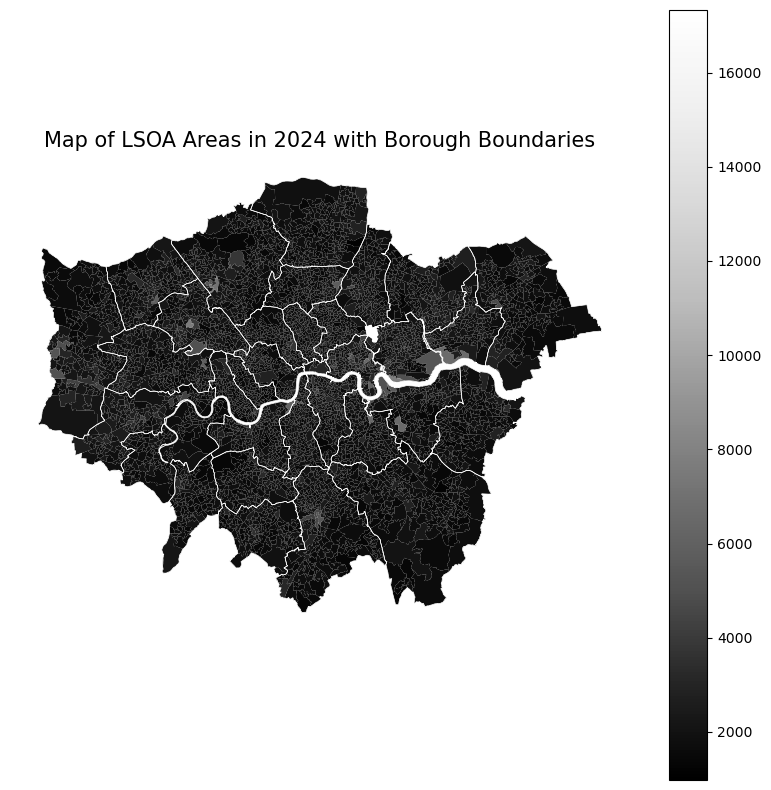

In [35]:
fig, ax = plt.subplots(figsize=(10, 10)) 
LSOA2024in11.plot(column='LSOA2024', ax=ax, legend=True, cmap='Greys_r', edgecolor='none')

Borough.boundary.plot(ax=ax, linewidth=0.5, color='White')

ax.set_title("Map of LSOA Areas in 2024 with Borough Boundaries", fontsize=15)
ax.set_axis_off()  

plt.show()

# 4 Results
Following the calculation of the 1km buffer and pedestrian catchment for each POI in ArcMap, the results were exported as separate shapefiles and imported into the current process. These shapefiles include the buffer and pedestrian catchment areas for each potential POI serving London, as well as the merged buffer and pedestrian catchment for all service POIs across London.

Download measured geodata:
- [1km Pedestrian Walkable Catchment](https://liveuclac-my.sharepoint.com/:u:/r/personal/ucfnlzu_ucl_ac_uk/Documents/Dissertation%20Data/1km%20Pedestrian%20Walkable%20Catchment.zip?csf=1&web=1&e=mKEcqP)
- [Merged 1km Buffer](https://liveuclac-my.sharepoint.com/:u:/r/personal/ucfnlzu_ucl_ac_uk/Documents/Dissertation%20Data/Merged%201km%20Buffer.zip?csf=1&web=1&e=laPxYm)

## 4.1 Coverage, Walkability, Cluster, Hierachical Tree

### 4.1.1 POIs Count of Serving London

In [36]:
def extract_and_load_shp(zip_path, output_dir):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(output_dir)

    zip_files = [os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.zip')]

    gdfs = {}
    temp_dir = "temp_shp" 
    for zip_file in zip_files:
        with zipfile.ZipFile(zip_file, 'r') as shp_zip_ref:
            shp_zip_ref.extractall(temp_dir)
            shp_files = [os.path.join(temp_dir, f) for f in os.listdir(temp_dir) if f.endswith('.shp')]
            for shp_file in shp_files:
                gdf_name = os.path.splitext(os.path.basename(shp_file))[0] 
                gdfs[gdf_name] = gpd.read_file(shp_file)
            shutil.rmtree(temp_dir)
    
    return gdfs

In [37]:
catchment_zip_path = "1km Pedestrian Walkable Catchment.zip"
Catchmentgdfs = extract_and_load_shp(catchment_zip_path, "catchment_unzipped_files")

for name, gdf in Catchmentgdfs.items():
    print(f"{name} Catchment GeoDataFrame:")
    print(f"{len(gdf)} {name}") 
    # gdf.info()
    print("\n")

DPS_ServingWithinL Catchment GeoDataFrame:
10419 DPS_ServingWithinL


DS_ServingWithinL Catchment GeoDataFrame:
53525 DS_ServingWithinL


EdS_ServingWithinL Catchment GeoDataFrame:
5717 EdS_ServingWithinL


EnF_ServingWithinL Catchment GeoDataFrame:
29043 EnF_ServingWithinL


FS_ServingWithinL Catchment GeoDataFrame:
12173 FS_ServingWithinL


HouS_ServingWithinL Catchment GeoDataFrame:
10944 HouS_ServingWithinL


HS_ServingWithinL Catchment GeoDataFrame:
10144 HS_ServingWithinL


PCS_ServingWithinL Catchment GeoDataFrame:
966 PCS_ServingWithinL


RS_ServingWithinL Catchment GeoDataFrame:
10625 RS_ServingWithinL


TLS_ServingWithinL Catchment GeoDataFrame:
30244 TLS_ServingWithinL




In [38]:
for name, gdf in Catchmentgdfs.items():
    print(f"{name} Catchment GeoDataFrame:")
    gdf.info()
    print("\n")

DPS_ServingWithinL Catchment GeoDataFrame:
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 10419 entries, 0 to 10418
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ObjectID    10419 non-null  int64   
 1   FacilityID  10419 non-null  int64   
 2   Name        10419 non-null  object  
 3   FromBreak   10419 non-null  float64 
 4   ToBreak     10419 non-null  float64 
 5   geometry    10419 non-null  geometry
dtypes: float64(2), geometry(1), int64(2), object(1)
memory usage: 488.5+ KB


DS_ServingWithinL Catchment GeoDataFrame:
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 53525 entries, 0 to 53524
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ObjectID    53525 non-null  int64   
 1   FacilityID  53525 non-null  int64   
 2   Name        53525 non-null  object  
 3   FromBreak   53525 non-null  float64 
 4   ToBreak    

### 4.1.2 1km Service  Buffer

In [39]:
Buffer_zip_path = "Merged 1km Buffer.zip"
Buffer_output_dir = "unzipped_files"

with zipfile.ZipFile(Buffer_zip_path, 'r') as zip_ref:
    zip_ref.extractall(Buffer_output_dir)


Buffer_shp_files = [os.path.join(Buffer_output_dir, f) for f in os.listdir(Buffer_output_dir) if f.endswith('.shp')]

gdfs = {}
for shp_file in Buffer_shp_files:
    gdf_name = os.path.splitext(os.path.basename(shp_file))[0] 
    gdfs[gdf_name] = gpd.read_file(shp_file)

    gdfs[gdf_name]['Area'] = gdfs[gdf_name].geometry.area / 1e6  
    
    print(f"{gdf_name} GeoDataFrame loaded with {len(gdfs[gdf_name])} records.")
    # print(gdfs[gdf_name][['geometry', 'Area']])  

    for idx, area in enumerate(gdfs[gdf_name]['Area']):
        print(f"The total area of {gdf_name} is {area:.6f} square kilometers")

# for name, gdf in gdfs.items():
#     # print(f"{name} GeoDataFrame:")
#     # gdf.info()
#     print("\n")

DPS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of DPS_MergedBuffer is 1720.443046 square kilometers
DS_MergedServed GeoDataFrame loaded with 1 records.
The total area of DS_MergedServed is 1380.845719 square kilometers
EdS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of EdS_MergedBuffer is 1643.429989 square kilometers
EnF_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of EnF_MergedBuffer is 1917.840223 square kilometers
FS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of FS_MergedBuffer is 1596.383397 square kilometers
HouS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of HouS_MergedBuffer is 1756.396125 square kilometers
HS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of HS_MergedBuffer is 1575.435974 square kilometers
PCS_MergedBuffer GeoDataFrame loaded with 1 records.
The total area of PCS_MergedBuffer is 1291.363697 square kilometers
RS_MergedBuffer GeoDataFrame loaded 

In [40]:
print("\nKeys in gdfs:")
print(gdfs.keys())


Keys in gdfs:
dict_keys(['DPS_MergedBuffer', 'DS_MergedServed', 'EdS_MergedBuffer', 'EnF_MergedBuffer', 'FS_MergedBuffer', 'HouS_MergedBuffer', 'HS_MergedBuffer', 'PCS_MergedBuffer', 'RS_MergedBuffer', 'TLS_MergedBuffer'])


In [41]:
first_key = list(gdfs.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
gdfs[first_key]


First GeoDataFrame (DPS_MergedBuffer):


,ref_no,name,pointx_cla,groupname,categoryna,classname,feature_ea,feature_no,pos_accura,uprn,...,qualifier_,qualifier1,provenance,supply_dat,OBJECTID,Location,BUFF_DIST,ORIG_FID,geometry,Area
0,48800482,One of Us Ltd,02080122,Daily Services and Professional Support,"It, Advertising, Marketing and Media Services",Film and Video Services,529617.0,181376.0,1,10033525483,...,NaN,NaN,118 Information,2024-06-01,23912,Inner,1000.0,0,"MULTIPOLYGON (((528770.254 157258.631, 528772....",1720.443046


### 4.1.3 Service Area Cluster Count

In [42]:
MergedCatchmentgdfs = {}
total_areas = {}  
coverage_ratios = {} 

total_area_constant = 1573.400741

for name, gdf in Catchmentgdfs.items():
    print(f"Processing {name} GeoDataFrame...")

    merged_polygons = []
    unmerged_polygons = list(gdf.geometry)

    while unmerged_polygons:
        polygon = unmerged_polygons.pop(0)
        merge_occurred = False

        for i in range(len(unmerged_polygons)):
            if polygon.intersects(unmerged_polygons[i]) or polygon.touches(unmerged_polygons[i]):
                polygon = unary_union([polygon, unmerged_polygons.pop(i)])
                merge_occurred = True
                break

        if merge_occurred:
            unmerged_polygons.append(polygon)
        else:
            merged_polygons.append(polygon)

    split_polygons = []
    for geom in merged_polygons:
        if isinstance(geom, MultiPolygon):
            split_polygons.extend(list(geom.geoms))  
        else:
            split_polygons.append(geom)

    new_name = name.replace("ServingWithinL", "ClusteredServed")
    merged_gdf = gpd.GeoDataFrame(geometry=split_polygons, crs=gdf.crs)
    merged_gdf['area_km2'] = merged_gdf['geometry'].area / 1e6

    filtered_gdf = merged_gdf[merged_gdf['area_km2'] > 0.000002]

    total_area = filtered_gdf['area_km2'].sum()

    coverage = total_area / total_area_constant

    total_areas[new_name] = total_area
    coverage_ratios[new_name] = coverage

    MergedCatchmentgdfs[new_name] = filtered_gdf

    print(f"{new_name} GeoDataFrame after merging, splitting, and filtering:")
    print(f"Total area: {total_area:.6f} square kilometers")
    print(f"Coverage: {coverage:.6%}")
    print(f"Cluster number: {len(filtered_gdf)} {new_name}")
    # print(filtered_gdf.head())  
    print("\n")

    # filtered_gdf.to_file(f"10-5 Result/{new_name}.shp")

Processing DPS_ServingWithinL GeoDataFrame...
DPS_ClusteredServed GeoDataFrame after merging, splitting, and filtering:
Total area: 1202.290839 square kilometers
Coverage: 76.413517%
Cluster number: 45 DPS_ClusteredServed


Processing DS_ServingWithinL GeoDataFrame...
DS_ClusteredServed GeoDataFrame after merging, splitting, and filtering:
Total area: 1282.264980 square kilometers
Coverage: 81.496401%
Cluster number: 43 DS_ClusteredServed


Processing EdS_ServingWithinL GeoDataFrame...
EdS_ClusteredServed GeoDataFrame after merging, splitting, and filtering:
Total area: 1180.922554 square kilometers
Coverage: 75.055421%
Cluster number: 49 EdS_ClusteredServed


Processing EnF_ServingWithinL GeoDataFrame...
EnF_ClusteredServed GeoDataFrame after merging, splitting, and filtering:
Total area: 1362.606743 square kilometers
Coverage: 86.602650%
Cluster number: 41 EnF_ClusteredServed


Processing FS_ServingWithinL GeoDataFrame...
FS_ClusteredServed GeoDataFrame after merging, splitting, and 

In [43]:
print("Keys in MergedNotServedByBGdfs:")
print(MergedCatchmentgdfs.keys())

Keys in MergedNotServedByBGdfs:
dict_keys(['DPS_ClusteredServed', 'DS_ClusteredServed', 'EdS_ClusteredServed', 'EnF_ClusteredServed', 'FS_ClusteredServed', 'HouS_ClusteredServed', 'HS_ClusteredServed', 'PCS_ClusteredServed', 'RS_ClusteredServed', 'TLS_ClusteredServed'])


In [44]:
first_key = list(MergedCatchmentgdfs.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
MergedCatchmentgdfs[first_key]


First GeoDataFrame (DPS_ClusteredServed):


,geometry,area_km2
0,"POLYGON ((542604.579 156837.579, 542603.300 15...",0.005702
1,"POLYGON ((545863.725 157394.925, 545511.960 15...",0.121496
2,"POLYGON ((556206.872 183886.515, 556281.503 18...",0.494030
3,"POLYGON ((552027.974 194053.687, 552106.307 19...",0.683549
4,"POLYGON ((529387.991 157315.124, 529419.643 15...",0.001987
5,"POLYGON ((518144.699 161282.036, 518146.300 16...",0.058085
6,"POLYGON ((513315.191 169027.996, 513281.500 16...",0.000598
7,"POLYGON ((505572.830 176064.940, 505529.425 17...",0.011657
8,"POLYGON ((505099.982 180207.533, 505231.625 18...",0.010661
9,"POLYGON ((504653.941 188448.533, 504660.064 18...",0.054115


### 4.1.4 Service Area Cluster by Borough

Plotting DPS_ClusteredServed with clusters...
Plotting DS_ClusteredServed with clusters...
Plotting EdS_ClusteredServed with clusters...
Plotting EnF_ClusteredServed with clusters...
Plotting FS_ClusteredServed with clusters...
Plotting HouS_ClusteredServed with clusters...
Plotting HS_ClusteredServed with clusters...
Plotting PCS_ClusteredServed with clusters...
Plotting RS_ClusteredServed with clusters...
Plotting TLS_ClusteredServed with clusters...


/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


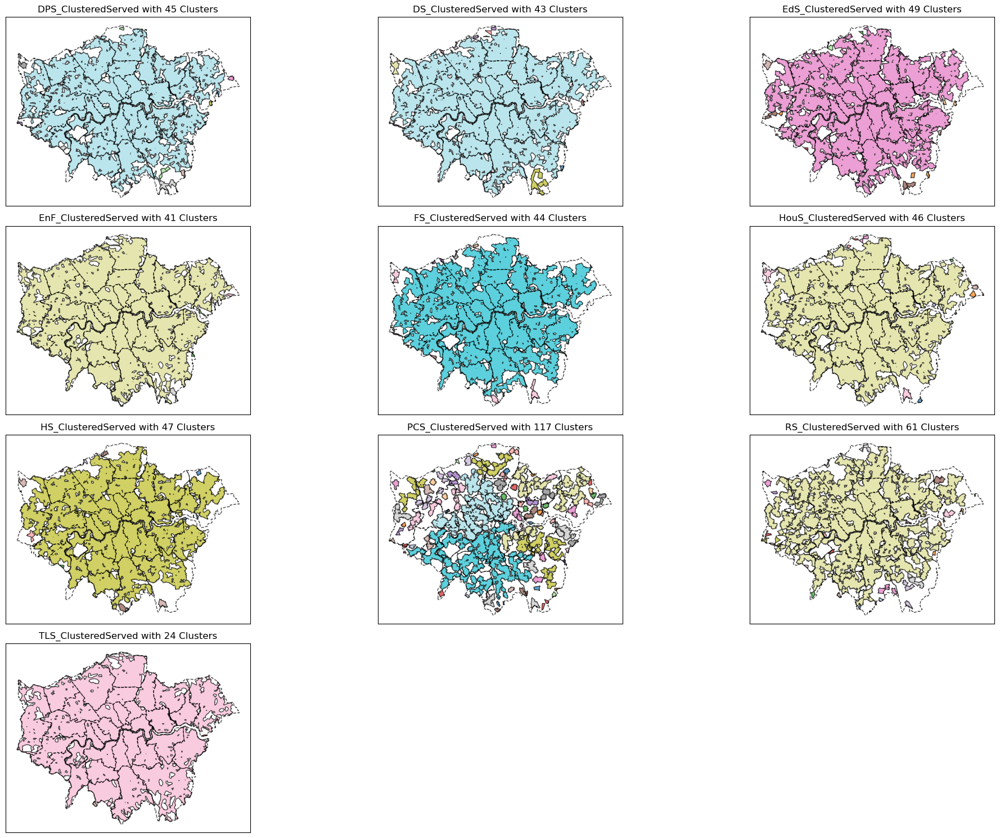

In [45]:
np.random.seed(42)

fig, axes = plt.subplots(4, 3, figsize=(20, 15))

axes = axes.flatten()

for idx, (name, gdf) in enumerate(MergedCatchmentgdfs.items()):
    if idx < len(axes):
        ax = axes[idx]
        
        print(f"Plotting {name} with clusters...")

        gdf['cluster_id'] = np.arange(len(gdf))

        n_clusters = len(gdf['cluster_id'].unique())
        cmap = plt.get_cmap('tab20', n_clusters)
        colors = cmap(np.linspace(0, 1, n_clusters))

        cluster_color_map = {cluster_id: colors[i] for i, cluster_id in enumerate(gdf['cluster_id'].unique())}


        for cluster_id, subset in gdf.groupby('cluster_id'):
            color = cluster_color_map[cluster_id]
            subset.plot(ax=ax, color=color, edgecolor='black', alpha=0.7, label=f'Cluster {cluster_id}')

        for _, borough_row in Borough.iterrows():
            gpd.GeoSeries(borough_row.geometry).boundary.plot(ax=ax, color='black', linewidth=1, linestyle='--', alpha=0.7)

        ax.set_title(f"{name} with {n_clusters} Clusters")
        ax.set_xticks([])
        ax.set_yticks([])

for idx in range(len(MergedCatchmentgdfs), len(axes)):
    fig.delaxes(axes[idx])

plt.tight_layout()
plt.show()
# plt.savefig("MergedCatchmentgdfs_clusters_4x3.png", dpi=300)

### 4.1.5 POI's SW by Type

In [46]:
SW_values = {}
for name in MergedCatchmentgdfs:
    base_name = name.replace("ClusteredServed", "MergedBuffer")
    if base_name in gdfs:
        merged_area = total_areas[name]
        original_area = gdfs[base_name]['Area'].sum()
        SW = merged_area / original_area
        SW_values[name] = SW
        print(f"SW value for {name}: {SW:.6f}")

# print("Final SW values:")
# for name, sw in SW_values.items():
#     print(f"{name}: {sw:.6f}")

SW value for DPS_ClusteredServed: 0.698826
SW value for EdS_ClusteredServed: 0.718572
SW value for EnF_ClusteredServed: 0.710490
SW value for FS_ClusteredServed: 0.733097
SW value for HouS_ClusteredServed: 0.710528
SW value for HS_ClusteredServed: 0.739020
SW value for PCS_ClusteredServed: 0.554503
SW value for RS_ClusteredServed: 0.674175
SW value for TLS_ClusteredServed: 0.734103


### 4.1.6 Cluster by Borough/MSOA/LSOA/OA - Hierarchical Tree

In [47]:
import geopandas as gpd
import numpy as np

DivideClustersbyDistricgdfs = {}

def calculate_intersection_counts(gdf, reference_gdf, column_name):
    counts = []
    for _, row in gdf.iterrows():
        intersection = reference_gdf[reference_gdf.geometry.intersects(row.geometry)]
        counts.append(len(intersection))
    gdf[column_name] = counts

for name, gdf in MergedCatchmentgdfs.items():
    print(f"Processing {name} for intersection counts...")

    calculate_intersection_counts(gdf, OA, 'OA_count')
    calculate_intersection_counts(gdf, LSOA, 'LSOA_count')
    calculate_intersection_counts(gdf, MSOA, 'MSOA_count')
    calculate_intersection_counts(gdf, Borough, 'Borough_count')
    gdf['Area_km2'] = gdf['geometry'].area / 1e6

    new_name = name.replace("ClusteredServed", "DivideClustersbyDistrict")
    DivideClustersbyDistricgdfs[new_name] = gdf

    print(f"{new_name} - Intersection counts and Area added.")
    print(gdf[['cluster_id', 'OA_count', 'LSOA_count', 'MSOA_count', 'Borough_count', 'Area_km2']].head())

Processing DPS_ClusteredServed for intersection counts...
DPS_DivideClustersbyDistrict - Intersection counts and Area added.
   cluster_id  OA_count  LSOA_count  MSOA_count  Borough_count  Area_km2
0           0         1           1           1              1  0.005702
1           1         2           1           1              1  0.121496
2           2         1           1           1              1  0.494030
3           3         2           1           1              1  0.683549
4           4         2           1           1              1  0.001987
Processing DS_ClusteredServed for intersection counts...
DS_DivideClustersbyDistrict - Intersection counts and Area added.
   cluster_id  OA_count  LSOA_count  MSOA_count  Borough_count  Area_km2
0           0         1           1           1              1  0.000081
1           1         1           1           1              1  0.874814
2           2         0           0           0              1  0.000139
3           3         

/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


TLS_DivideClustersbyDistrict - Intersection counts and Area added.
   cluster_id  OA_count  LSOA_count  MSOA_count  Borough_count  Area_km2
0           0         1           1           1              1  0.000002
2           1         0           0           0              1  0.000003
3           2         3           3           3              1  0.194247
4           3         1           1           1              1  0.002933
5           4         1           1           1              1  0.000903


/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/conda/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value 

In [48]:
for name, gdf in DivideClustersbyDistricgdfs.items():
    print(f"Processing {name} for Area_km2 statistics...")

    max_area_row = gdf.loc[gdf['Area_km2'].idxmax()]
    min_area_row = gdf.loc[gdf['Area_km2'].idxmin()]

    print(f"\n{name}:")
    print(f"Maximum Area_km2: {max_area_row['Area_km2']:.6f} square kilometers")
    print("Row with maximum Area_km2:")
    print(max_area_row)
    
    print(f"\nMinimum Area_km2: {min_area_row['Area_km2']:.6f} square kilometers")
    print("Row with minimum Area_km2:")
    print(min_area_row)
    print("\n" + "="*60 + "\n")

Processing DPS_DivideClustersbyDistrict for Area_km2 statistics...

DPS_DivideClustersbyDistrict:
Maximum Area_km2: 1181.316429 square kilometers
Row with maximum Area_km2:
geometry         POLYGON ((517457.2000000011 174758.6000000015,...
area_km2                                               1181.316429
cluster_id                                                      42
OA_count                                                     24892
LSOA_count                                                    4823
MSOA_count                                                     983
Borough_count                                                   33
Area_km2                                               1181.316429
Name: 42, dtype: object

Minimum Area_km2: 0.000037 square kilometers
Row with minimum Area_km2:
geometry         POLYGON ((519529.2749821289 164268.004773468, ...
area_km2                                                  0.000037
cluster_id                                                  

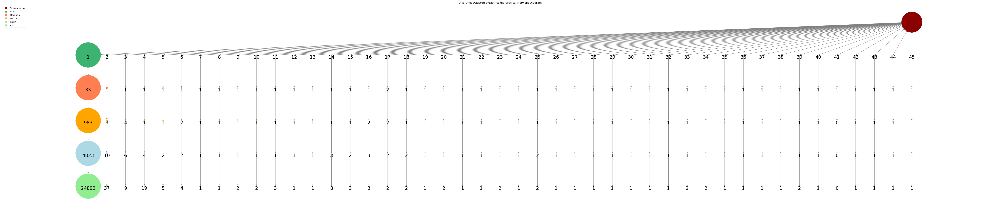

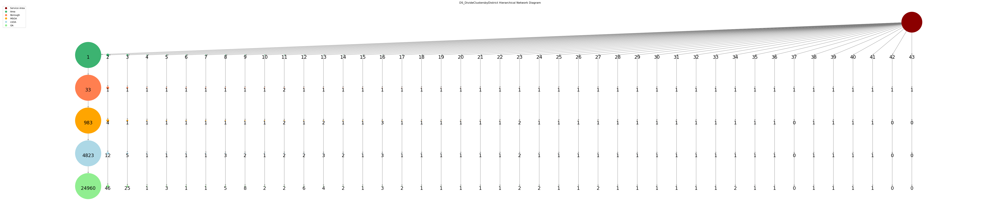

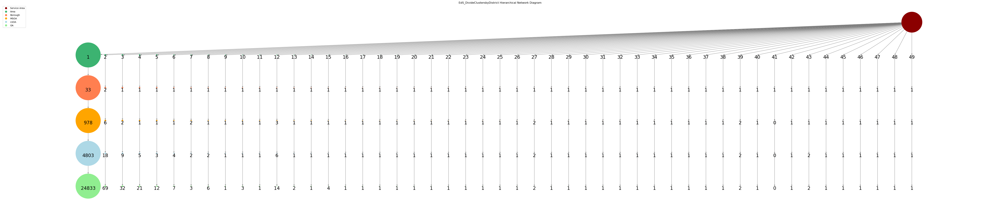

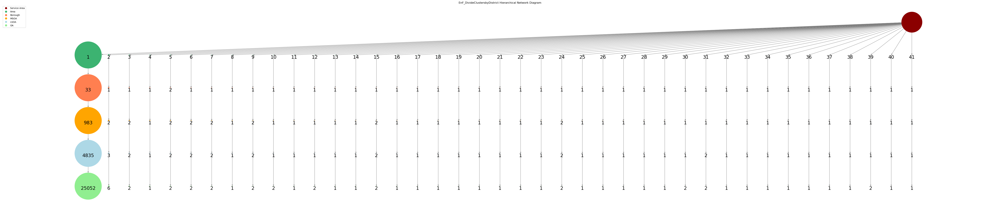

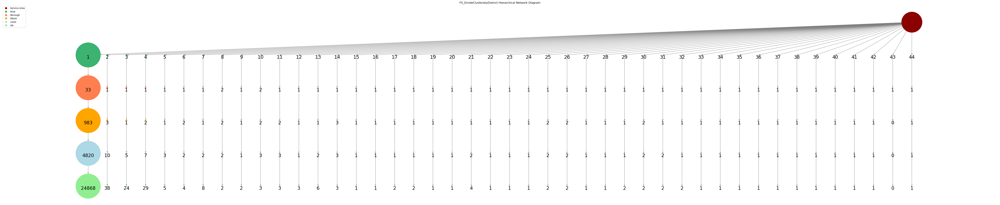

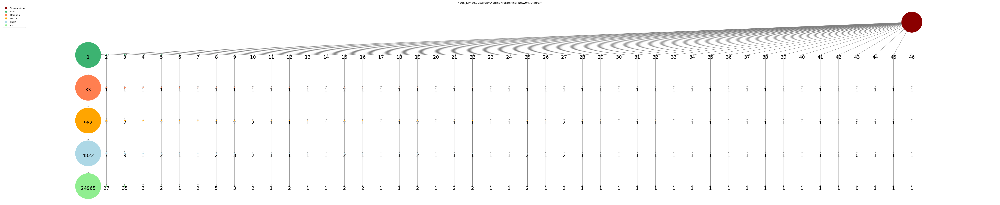

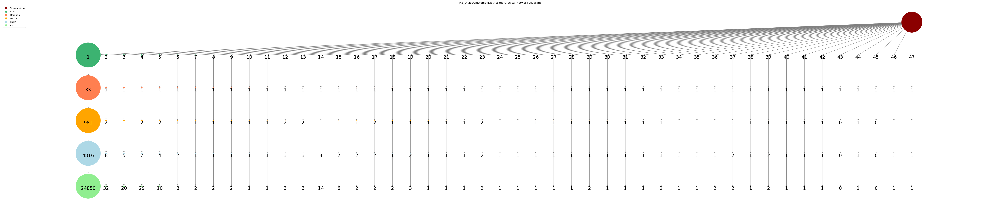

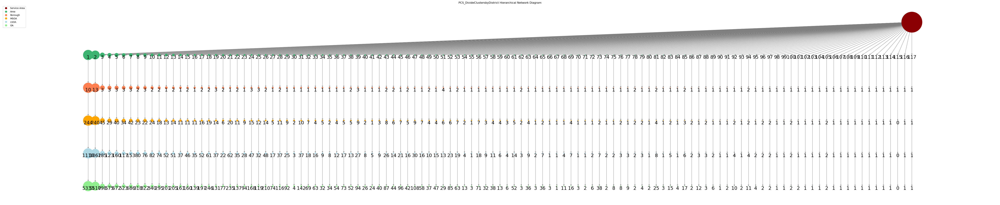

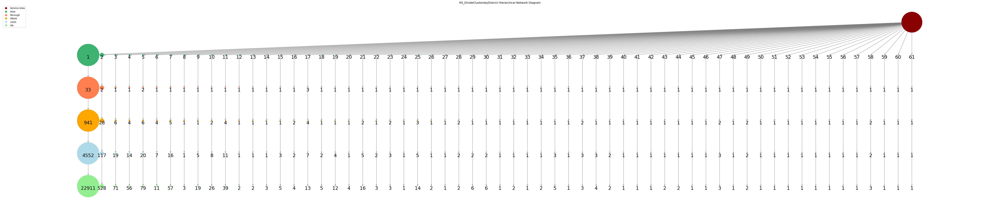

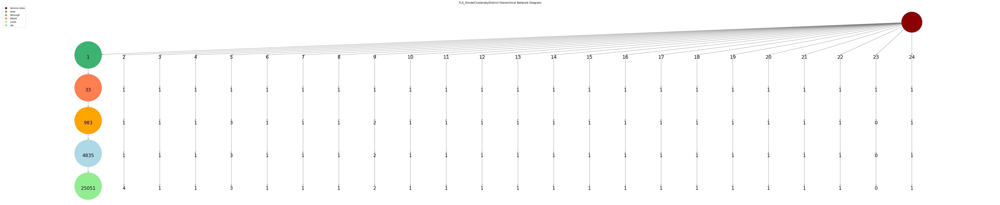

In [49]:
def generate_hierarchical_tree_with_service_area(gdf_filtered, new_name):
    G = nx.DiGraph()

    service_area_node = f"ServiceArea_{new_name}"
    sorted_gdf = gdf_filtered.sort_values(by='Area_km2', ascending=False).reset_index(drop=True)

    for idx, row in sorted_gdf.iterrows():
        lsoa_node = f"LSOA_{new_name}_{idx}_{int(row['LSOA_count'])}"
        msoa_node = f"MSOA_{new_name}_{idx}_{int(row['MSOA_count'])}"
        borough_node = f"Borough_{new_name}_{idx}_{int(row['Borough_count'])}"
        area_node = f"Area_{new_name}_{idx + 1}"  # 顺位标注从 1 开始
        oa_node = f"OA_{new_name}_{idx}_{int(row['OA_count'])}"

        G.add_edge(service_area_node, area_node)
        G.add_edge(area_node, borough_node)
        G.add_edge(borough_node, msoa_node)
        G.add_edge(msoa_node, lsoa_node)
        G.add_edge(lsoa_node, oa_node)

    scaling_factor = 10
    node_size = []
    area_node_labels = {}

    for node in G.nodes():
        if node.startswith('Area_'):
            node_idx = int(node.split('_')[3]) - 1
            size = sorted_gdf.at[node_idx, 'Area_km2'] * scaling_factor
            node_size.append(size)
            area_node_labels[node] = f"{node_idx + 1}"  
        elif node.startswith(('LSOA_', 'MSOA_', 'Borough_', 'OA_')):
            node_idx = int(node.split('_')[3]) 
            size = sorted_gdf.at[node_idx, 'Area_km2'] * scaling_factor
            node_size.append(size)
        else:
            node_size.append(8000) 
            
    layer_colors = {
        "ServiceArea": "darkred",
        "Area": "mediumseagreen",
        "Borough": "coral",
        "MSOA": "orange",
        "LSOA": "lightblue",
        "OA": "lightgreen"
    }

    node_color = []
    for node in G.nodes():
        if node.startswith('ServiceArea_'):
            node_color.append(layer_colors["ServiceArea"])
        elif node.startswith('Area_'):
            node_color.append(layer_colors["Area"])
        elif node.startswith('Borough_'):
            node_color.append(layer_colors["Borough"])
        elif node.startswith('MSOA_'):
            node_color.append(layer_colors["MSOA"])
        elif node.startswith('LSOA_'):
            node_color.append(layer_colors["LSOA"])
        elif node.startswith('OA_'):
            node_color.append(layer_colors["OA"])

    pos = {}
    layer_spacing = 1.5
    for i, (idx, row) in enumerate(sorted_gdf.iterrows()):
        x_position = i * layer_spacing

        pos[f"ServiceArea_{new_name}"] = (x_position, 0)
        pos[f"Area_{new_name}_{idx + 1}"] = (x_position, -1 * layer_spacing)
        pos[f"Borough_{new_name}_{idx}_{int(row['Borough_count'])}"] = (x_position, -2 * layer_spacing)
        pos[f"MSOA_{new_name}_{idx}_{int(row['MSOA_count'])}"] = (x_position, -3 * layer_spacing)
        pos[f"LSOA_{new_name}_{idx}_{int(row['LSOA_count'])}"] = (x_position, -4 * layer_spacing)
        pos[f"OA_{new_name}_{idx}_{int(row['OA_count'])}"] = (x_position, -5 * layer_spacing)

    plt.figure(figsize=(60, 12))  
    nx.draw(G, pos, with_labels=False, node_size=node_size, node_color=node_color, font_size=10, font_weight='bold',
            edge_color='gray', verticalalignment='top', arrows=True, arrowstyle='-|>', arrowsize=10,
            bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.3'))

    labels = {**area_node_labels}
    for node in G.nodes():
        if not node.startswith('ServiceArea_'):
            labels[node] = node.split('_')[-1]
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=20, verticalalignment='top')

    plt.legend(handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='Service Area', markersize=10, markerfacecolor='darkred'),
        plt.Line2D([0], [0], marker='o', color='w', label='Area', markersize=10, markerfacecolor='mediumseagreen'),
        plt.Line2D([0], [0], marker='o', color='w', label='Borough', markersize=10, markerfacecolor='coral'),
        plt.Line2D([0], [0], marker='o', color='w', label='MSOA', markersize=10, markerfacecolor='orange'),
        plt.Line2D([0], [0], marker='o', color='w', label='LSOA', markersize=10, markerfacecolor='lightblue'),
        plt.Line2D([0], [0], marker='o', color='w', label='OA', markersize=10, markerfacecolor='lightgreen')],
               loc='upper left')

    plt.title(f"{new_name} Hierarchical Network Diagram")
    plt.savefig(f'{new_name}_Hierarchical_Network_Diagram_with_ServiceArea.png', dpi=300, bbox_inches='tight') 
    plt.show()

for new_name in DivideClustersbyDistricgdfs.keys():
    gdf_filtered = DivideClustersbyDistricgdfs[new_name] 
    generate_hierarchical_tree_with_service_area(gdf_filtered, new_name)

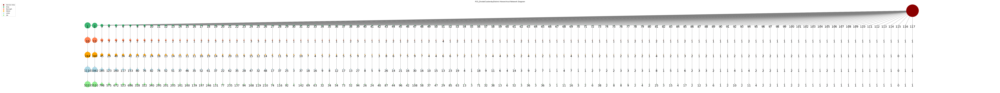

In [50]:
import networkx as nx
import matplotlib.pyplot as plt

def generate_hierarchical_tree_with_service_area(gdf_filtered, new_name):
    G = nx.DiGraph()
    service_area_node = f"ServiceArea_{new_name}"
    sorted_gdf = gdf_filtered.sort_values(by='Area_km2', ascending=False).reset_index(drop=True)

    for idx, row in sorted_gdf.iterrows():
        lsoa_node = f"LSOA_{new_name}_{idx}_{int(row['LSOA_count'])}"
        msoa_node = f"MSOA_{new_name}_{idx}_{int(row['MSOA_count'])}"
        borough_node = f"Borough_{new_name}_{idx}_{int(row['Borough_count'])}"
        area_node = f"Area_{new_name}_{idx + 1}" 
        oa_node = f"OA_{new_name}_{idx}_{int(row['OA_count'])}"

        G.add_edge(service_area_node, area_node)
        G.add_edge(area_node, borough_node)
        G.add_edge(borough_node, msoa_node)
        G.add_edge(msoa_node, lsoa_node)
        G.add_edge(lsoa_node, oa_node)

    scaling_factor = 10
    node_size = []
    area_node_labels = {}

    for node in G.nodes():
        if node.startswith('Area_'):
            node_idx = int(node.split('_')[3]) - 1 
            size = sorted_gdf.at[node_idx, 'Area_km2'] * scaling_factor
            node_size.append(size)
            area_node_labels[node] = f"{node_idx + 1}"  
        elif node.startswith(('LSOA_', 'MSOA_', 'Borough_', 'OA_')):
            node_idx = int(node.split('_')[3])  
            size = sorted_gdf.at[node_idx, 'Area_km2'] * scaling_factor
            node_size.append(size)
        else:
            node_size.append(8000) 

    layer_colors = {
        "ServiceArea": "darkred",
        "Area": "mediumseagreen",
        "Borough": "coral",
        "MSOA": "orange",
        "LSOA": "lightblue",
        "OA": "lightgreen"
    }

    node_color = []
    for node in G.nodes():
        if node.startswith('ServiceArea_'):
            node_color.append(layer_colors["ServiceArea"])
        elif node.startswith('Area_'):
            node_color.append(layer_colors["Area"])
        elif node.startswith('Borough_'):
            node_color.append(layer_colors["Borough"])
        elif node.startswith('MSOA_'):
            node_color.append(layer_colors["MSOA"])
        elif node.startswith('LSOA_'):
            node_color.append(layer_colors["LSOA"])
        elif node.startswith('OA_'):
            node_color.append(layer_colors["OA"])

    pos = {}
    layer_spacing = 1.5
    for i, (idx, row) in enumerate(sorted_gdf.iterrows()):
        x_position = i * layer_spacing

        pos[f"ServiceArea_{new_name}"] = (x_position, 0)
        pos[f"Area_{new_name}_{idx + 1}"] = (x_position, -1 * layer_spacing)
        pos[f"Borough_{new_name}_{idx}_{int(row['Borough_count'])}"] = (x_position, -2 * layer_spacing)
        pos[f"MSOA_{new_name}_{idx}_{int(row['MSOA_count'])}"] = (x_position, -3 * layer_spacing)
        pos[f"LSOA_{new_name}_{idx}_{int(row['LSOA_count'])}"] = (x_position, -4 * layer_spacing)
        pos[f"OA_{new_name}_{idx}_{int(row['OA_count'])}"] = (x_position, -5 * layer_spacing)

    plt.figure(figsize=(100, 9)) 
    nx.draw(G, pos, with_labels=False, node_size=node_size, node_color=node_color, font_size=10, font_weight='bold',
            edge_color='gray', verticalalignment='top', arrows=True, arrowstyle='-|>', arrowsize=10,
            bbox=dict(facecolor='white', edgecolor='none', boxstyle='round,pad=0.3'))

    labels = {**area_node_labels}
    for node in G.nodes():
        if not node.startswith('ServiceArea_'):
            labels[node] = node.split('_')[-1]
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=20, verticalalignment='top')

    plt.legend(handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='Service Area', markersize=10, markerfacecolor='darkred'),
        plt.Line2D([0], [0], marker='o', color='w', label='Area', markersize=10, markerfacecolor='mediumseagreen'),
        plt.Line2D([0], [0], marker='o', color='w', label='Borough', markersize=10, markerfacecolor='coral'),
        plt.Line2D([0], [0], marker='o', color='w', label='MSOA', markersize=10, markerfacecolor='orange'),
        plt.Line2D([0], [0], marker='o', color='w', label='LSOA', markersize=10, markerfacecolor='lightblue'),
        plt.Line2D([0], [0], marker='o', color='w', label='OA', markersize=10, markerfacecolor='lightgreen')],
               loc='upper left')

    plt.title(f"{new_name} Hierarchical Network Diagram")
    plt.savefig(f'{new_name}_Hierarchical_Network_Diagram_with_ServiceArea.png', dpi=300, bbox_inches='tight')  # 保存图像
    plt.show()


specific_name = "PCS_DivideClustersbyDistrict"

if specific_name in DivideClustersbyDistricgdfs:
    gdf_filtered = DivideClustersbyDistricgdfs[specific_name]  
    generate_hierarchical_tree_with_service_area(gdf_filtered, specific_name)
else:
    print(f"{specific_name} not found in DivideClustersbyDistricgdfs.")

### 4.1.7 Served Area by LSOA

In [51]:
ServedAreaByLSOA = {}

for name, gdf in Catchmentgdfs.items():
    print(f"Processing {name}...")

    merged_geometries = []
    total_service_areas = []

    original_data = []

    for idx, row in gdf.iterrows():
        merged_geometry = unary_union([row.geometry])
        area_km2 = merged_geometry.area / 1e6
        merged_geometries.append(merged_geometry)
        total_service_areas.append(area_km2)
        original_data.append(row.drop('geometry')) 
        
    merged_gdf = gpd.GeoDataFrame(original_data, geometry=merged_geometries, crs=gdf.crs)
    merged_gdf['Total Service Area'] = total_service_areas
    
    new_name = name.replace('ServingWithinL', 'ServedAreaByLSOA')
    ServedAreaByLSOA[new_name] = merged_gdf

    print(f"{new_name} created with {len(merged_gdf)} rows.")
    print(merged_gdf.info())  
    print("\n")

print("\nKeys in ServedAreaByLSOA:")
print(ServedAreaByLSOA.keys())

first_key = list(ServedAreaByLSOA.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
ServedAreaByLSOA[first_key]

Processing DPS_ServingWithinL...
DPS_ServedAreaByLSOA created with 10419 rows.
<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 10419 entries, 0 to 10418
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   ObjectID            10419 non-null  int64   
 1   FacilityID          10419 non-null  int64   
 2   Name                10419 non-null  object  
 3   FromBreak           10419 non-null  float64 
 4   ToBreak             10419 non-null  float64 
 5   geometry            10419 non-null  geometry
 6   Total Service Area  10419 non-null  float64 
dtypes: float64(3), geometry(1), int64(2), object(1)
memory usage: 651.2+ KB
None


Processing DS_ServingWithinL...
DS_ServedAreaByLSOA created with 53525 rows.
<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 53525 entries, 0 to 53524
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              -------------

,ObjectID,FacilityID,Name,FromBreak,ToBreak,geometry,Total Service Area
0,9700,9700,Omniweb : 0 - 1000,0.0,1000.0,"POLYGON ((540837.613 156807.203, 540994.365 15...",0.030314
1,5076,5076,John Panther Associates : 0 - 1000,0.0,1000.0,"POLYGON ((542604.579 156837.579, 542603.300 15...",0.005702
2,5074,5074,Orpington Saab Ltd : 0 - 1000,0.0,1000.0,"POLYGON ((540808.658 156781.773, 540884.059 15...",0.039839
3,5099,5099,Tatsfield Garage : 0 - 1000,0.0,1000.0,"POLYGON ((540808.658 156781.773, 540884.059 15...",0.039839
4,5089,5089,Paul Watson Services : 0 - 1000,0.0,1000.0,"POLYGON ((540917.500 156841.108, 540940.399 15...",0.010990
...,...,...,...,...,...,...,...
10414,2953,2953,Kmax MOT : 0 - 1000,0.0,1000.0,"POLYGON ((525764.360 197038.110, 525765.206 19...",1.218153
10415,2339,2339,K Max Ltd : 0 - 1000,0.0,1000.0,"POLYGON ((525764.360 197038.110, 525765.206 19...",1.218153
10416,2879,2879,Mask : 0 - 1000,0.0,1000.0,"POLYGON ((525785.184 196988.506, 525821.726 19...",1.181900
10417,7347,7347,Get Top Listing : 0 - 1000,0.0,1000.0,"POLYGON ((525238.694 197402.220, 525242.096 19...",1.148503


### 4.1.8 Merged Served Area by LSOA

In [52]:
MergedServedArea = {}

for name, gdf in MergedCatchmentgdfs.items():
    print(f"Processing {name}...")
    merged_geometry = unary_union(gdf.geometry)
    merged_gdf = gpd.GeoDataFrame(geometry=[merged_geometry], crs=gdf.crs)
    merged_gdf['Total Service Area'] = merged_gdf.geometry.area / 1e6 
    MergedServedArea[name] = merged_gdf

    print(f"{name} merged into a single geometry with the following total service area(s):")
    for idx, area in enumerate(merged_gdf['Total Service Area']):
        print(f" - Area {idx + 1}: {area:.6f} square kilometers")
    print(f"New GeoDataFrame has {len(merged_gdf)} row(s).")
    print("\n")

print("\nKeys in MergedServedArea:")
print(MergedServedArea.keys())

first_key = list(MergedServedArea.keys())[0]
print(f"\nFirst Merged GeoDataFrame ({first_key}):")
MergedServedArea[first_key]

Processing DPS_ClusteredServed...
DPS_ClusteredServed merged into a single geometry with the following total service area(s):
 - Area 1: 1202.290839 square kilometers
New GeoDataFrame has 1 row(s).


Processing DS_ClusteredServed...
DS_ClusteredServed merged into a single geometry with the following total service area(s):
 - Area 1: 1282.264980 square kilometers
New GeoDataFrame has 1 row(s).


Processing EdS_ClusteredServed...
EdS_ClusteredServed merged into a single geometry with the following total service area(s):
 - Area 1: 1180.922554 square kilometers
New GeoDataFrame has 1 row(s).


Processing EnF_ClusteredServed...
EnF_ClusteredServed merged into a single geometry with the following total service area(s):
 - Area 1: 1362.606743 square kilometers
New GeoDataFrame has 1 row(s).


Processing FS_ClusteredServed...
FS_ClusteredServed merged into a single geometry with the following total service area(s):
 - Area 1: 1170.303187 square kilometers
New GeoDataFrame has 1 row(s).


Proc

,geometry,Total Service Area
0,"MULTIPOLYGON (((513202.766 168975.031, 513315....",1202.290839


In [53]:
MergedServedAreaByLSOA = {}

for name, gdf in MergedServedArea.items():
    print(f"Processing {name}...")
    served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')
    served_cover_gdf['LSOAServedArea'] = served_cover_gdf['geometry'].area / 1e6
    served_cover_gdf['CoverPotential'] = 1 - (served_cover_gdf['LSOAServedArea'] / served_cover_gdf['Area'])
    new_name = name.replace('MergedServedArea', 'MergedServedAreaByLSOA')
    MergedServedAreaByLSOA[new_name] = served_cover_gdf

    print(f"{new_name} GeoDataFrame created with {len(served_cover_gdf)} records.")
    print(served_cover_gdf.info())  
    print("\n")

print("\nKeys in MergedServedAreaByLSOA:")
print(MergedServedAreaByLSOA.keys())

first_key = list(MergedServedAreaByLSOA.keys())[0]
print(f"\nFirst Merged GeoDataFrame ({first_key}):")
MergedServedAreaByLSOA[first_key]

Processing DPS_ClusteredServed...


/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


DPS_ClusteredServed GeoDataFrame created with 4834 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4834 entries, 0 to 4833
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4834 non-null   float64 
 1   LSOA11CD            4834 non-null   object  
 2   LSOA11NM            4834 non-null   object  
 3   MSOA11CD            4834 non-null   object  
 4   MSOA11NM            4834 non-null   object  
 5   LAD11CD             4834 non-null   object  
 6   LAD11NM             4834 non-null   object  
 7   RGN11CD             4834 non-null   object  
 8   RGN11NM             4834 non-null   object  
 9   LSOA2024            4834 non-null   int64   
 10  Area                4834 non-null   float64 
 11  2024POPDEN          4834 non-null   float64 
 12  geometry            4834 non-null   geometry
 13  LSOAServedArea      4834 non-null   float64 
 14  CoverPotential      

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


DS_ClusteredServed GeoDataFrame created with 4835 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4835 non-null   float64 
 1   LSOA11CD            4835 non-null   object  
 2   LSOA11NM            4835 non-null   object  
 3   MSOA11CD            4835 non-null   object  
 4   MSOA11NM            4835 non-null   object  
 5   LAD11CD             4835 non-null   object  
 6   LAD11NM             4835 non-null   object  
 7   RGN11CD             4835 non-null   object  
 8   RGN11NM             4835 non-null   object  
 9   LSOA2024            4835 non-null   int64   
 10  Area                4835 non-null   float64 
 11  2024POPDEN          4835 non-null   float64 
 12  geometry            4835 non-null   geometry
 13  LSOAServedArea      4835 non-null   float64 
 14  CoverPotential      4

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


EdS_ClusteredServed GeoDataFrame created with 4834 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4834 entries, 0 to 4833
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4834 non-null   float64 
 1   LSOA11CD            4834 non-null   object  
 2   LSOA11NM            4834 non-null   object  
 3   MSOA11CD            4834 non-null   object  
 4   MSOA11NM            4834 non-null   object  
 5   LAD11CD             4834 non-null   object  
 6   LAD11NM             4834 non-null   object  
 7   RGN11CD             4834 non-null   object  
 8   RGN11NM             4834 non-null   object  
 9   LSOA2024            4834 non-null   int64   
 10  Area                4834 non-null   float64 
 11  2024POPDEN          4834 non-null   float64 
 12  geometry            4834 non-null   geometry
 13  LSOAServedArea      4834 non-null   float64 
 14  CoverPotential      

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


EnF_ClusteredServed GeoDataFrame created with 4835 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4835 non-null   float64 
 1   LSOA11CD            4835 non-null   object  
 2   LSOA11NM            4835 non-null   object  
 3   MSOA11CD            4835 non-null   object  
 4   MSOA11NM            4835 non-null   object  
 5   LAD11CD             4835 non-null   object  
 6   LAD11NM             4835 non-null   object  
 7   RGN11CD             4835 non-null   object  
 8   RGN11NM             4835 non-null   object  
 9   LSOA2024            4835 non-null   int64   
 10  Area                4835 non-null   float64 
 11  2024POPDEN          4835 non-null   float64 
 12  geometry            4835 non-null   geometry
 13  LSOAServedArea      4835 non-null   float64 
 14  CoverPotential      

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


FS_ClusteredServed GeoDataFrame created with 4835 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4835 non-null   float64 
 1   LSOA11CD            4835 non-null   object  
 2   LSOA11NM            4835 non-null   object  
 3   MSOA11CD            4835 non-null   object  
 4   MSOA11NM            4835 non-null   object  
 5   LAD11CD             4835 non-null   object  
 6   LAD11NM             4835 non-null   object  
 7   RGN11CD             4835 non-null   object  
 8   RGN11NM             4835 non-null   object  
 9   LSOA2024            4835 non-null   int64   
 10  Area                4835 non-null   float64 
 11  2024POPDEN          4835 non-null   float64 
 12  geometry            4835 non-null   geometry
 13  LSOAServedArea      4835 non-null   float64 
 14  CoverPotential      4

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


HouS_ClusteredServed GeoDataFrame created with 4835 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4835 non-null   float64 
 1   LSOA11CD            4835 non-null   object  
 2   LSOA11NM            4835 non-null   object  
 3   MSOA11CD            4835 non-null   object  
 4   MSOA11NM            4835 non-null   object  
 5   LAD11CD             4835 non-null   object  
 6   LAD11NM             4835 non-null   object  
 7   RGN11CD             4835 non-null   object  
 8   RGN11NM             4835 non-null   object  
 9   LSOA2024            4835 non-null   int64   
 10  Area                4835 non-null   float64 
 11  2024POPDEN          4835 non-null   float64 
 12  geometry            4835 non-null   geometry
 13  LSOAServedArea      4835 non-null   float64 
 14  CoverPotential     

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


HS_ClusteredServed GeoDataFrame created with 4834 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4834 entries, 0 to 4833
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4834 non-null   float64 
 1   LSOA11CD            4834 non-null   object  
 2   LSOA11NM            4834 non-null   object  
 3   MSOA11CD            4834 non-null   object  
 4   MSOA11NM            4834 non-null   object  
 5   LAD11CD             4834 non-null   object  
 6   LAD11NM             4834 non-null   object  
 7   RGN11CD             4834 non-null   object  
 8   RGN11NM             4834 non-null   object  
 9   LSOA2024            4834 non-null   int64   
 10  Area                4834 non-null   float64 
 11  2024POPDEN          4834 non-null   float64 
 12  geometry            4834 non-null   geometry
 13  LSOAServedArea      4834 non-null   float64 
 14  CoverPotential      4

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


PCS_ClusteredServed GeoDataFrame created with 4265 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4265 entries, 0 to 4264
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4265 non-null   float64 
 1   LSOA11CD            4265 non-null   object  
 2   LSOA11NM            4265 non-null   object  
 3   MSOA11CD            4265 non-null   object  
 4   MSOA11NM            4265 non-null   object  
 5   LAD11CD             4265 non-null   object  
 6   LAD11NM             4265 non-null   object  
 7   RGN11CD             4265 non-null   object  
 8   RGN11NM             4265 non-null   object  
 9   LSOA2024            4265 non-null   int64   
 10  Area                4265 non-null   float64 
 11  2024POPDEN          4265 non-null   float64 
 12  geometry            4265 non-null   geometry
 13  LSOAServedArea      4265 non-null   float64 
 14  CoverPotential      

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


RS_ClusteredServed GeoDataFrame created with 4762 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4762 entries, 0 to 4761
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4762 non-null   float64 
 1   LSOA11CD            4762 non-null   object  
 2   LSOA11NM            4762 non-null   object  
 3   MSOA11CD            4762 non-null   object  
 4   MSOA11NM            4762 non-null   object  
 5   LAD11CD             4762 non-null   object  
 6   LAD11NM             4762 non-null   object  
 7   RGN11CD             4762 non-null   object  
 8   RGN11NM             4762 non-null   object  
 9   LSOA2024            4762 non-null   int64   
 10  Area                4762 non-null   float64 
 11  2024POPDEN          4762 non-null   float64 
 12  geometry            4762 non-null   geometry
 13  LSOAServedArea      4762 non-null   float64 
 14  CoverPotential      4

/tmp/ipykernel_20453/2119056224.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  served_cover_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


TLS_ClusteredServed GeoDataFrame created with 4835 records.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Total Service Area  4835 non-null   float64 
 1   LSOA11CD            4835 non-null   object  
 2   LSOA11NM            4835 non-null   object  
 3   MSOA11CD            4835 non-null   object  
 4   MSOA11NM            4835 non-null   object  
 5   LAD11CD             4835 non-null   object  
 6   LAD11NM             4835 non-null   object  
 7   RGN11CD             4835 non-null   object  
 8   RGN11NM             4835 non-null   object  
 9   LSOA2024            4835 non-null   int64   
 10  Area                4835 non-null   float64 
 11  2024POPDEN          4835 non-null   float64 
 12  geometry            4835 non-null   geometry
 13  LSOAServedArea      4835 non-null   float64 
 14  CoverPotential      

,Total Service Area,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,LSOA2024,Area,2024POPDEN,geometry,LSOAServedArea,CoverPotential
0,1202.290839,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,2158,0.133321,16186.525314,"POLYGON ((532162.491 181867.763, 532248.316 18...",0.133321,0.000000e+00
1,1202.290839,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,2016,0.226191,8912.810705,"POLYGON ((532671.688 181574.109, 532614.313 18...",0.226191,0.000000e+00
2,1202.290839,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,2289,0.057303,39945.575922,"POLYGON ((532158.250 182151.062, 532252.872 18...",0.057303,1.110223e-16
3,1202.290839,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,2012,0.190739,10548.459027,"POLYGON ((533649.063 180733.859, 533602.438 18...",0.190739,1.110223e-16
4,1202.290839,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1871,0.144196,12975.408382,"POLYGON ((545271.917 184183.948, 545296.313 18...",0.144196,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4829,1202.290839,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1387,0.123309,11248.148255,"POLYGON ((544222.000 179482.200, 544235.800 17...",0.050567,5.899165e-01
4830,1202.290839,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1973,1.004853,1963.471103,"MULTIPOLYGON (((545901.013 180082.315, 545911....",0.313799,6.877165e-01
4831,1202.290839,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1802,0.152262,11834.864110,"POLYGON ((544740.120 179446.679, 544772.380 17...",0.145900,4.178242e-02
4832,1202.290839,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1709,0.558478,3060.104266,"MULTIPOLYGON (((545773.380 179919.801, 545778....",0.539851,3.335275e-02


## 4.2 Not Served, Population and Area Coverage Development Potential

### 4.2.1 Area Not Served Within London by Borough

In [54]:
if LondonBoundary.crs != list(MergedCatchmentgdfs.values())[0].crs:
    LondonBoundary = LondonBoundary.to_crs(list(MergedCatchmentgdfs.values())[0].crs)

MergedNotServedGdfs = {}

for name, gdf in MergedCatchmentgdfs.items():
    print(f"Processing {name} for not served area...")

    not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')
    not_served_name = f"{name}MergedNotServedWithinL"
    MergedNotServedGdfs[not_served_name] = not_served_gdf
    
    print(f"{not_served_name} GeoDataFrame created.")
    print(f"Total not served area: {not_served_gdf['geometry'].area.sum() / 1e6:.6f} square kilometers")
    print(f"Polygon count: {len(not_served_gdf)}")
    print("\n")

    # not_served_gdf.to_file(f"10-5 Result/{not_served_name}.shp")

Processing DPS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 737 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


DPS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 371.109902 square kilometers
Polygon count: 1


Processing DS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 610 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


DS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 291.135761 square kilometers
Polygon count: 1


Processing EdS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 737 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


EdS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 392.478187 square kilometers
Polygon count: 1


Processing EnF_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 513 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


EnF_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 210.793998 square kilometers
Polygon count: 1


Processing FS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 711 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


FS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 403.097554 square kilometers
Polygon count: 1


Processing HouS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 540 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


HouS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 325.432239 square kilometers
Polygon count: 1


Processing HS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 649 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


HS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 409.122020 square kilometers
Polygon count: 1


Processing PCS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 574 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


PCS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 857.336253 square kilometers
Polygon count: 1


Processing RS_ClusteredServed for not served area...


/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 732 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


RS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 589.570491 square kilometers
Polygon count: 1


Processing TLS_ClusteredServed for not served area...
TLS_ClusteredServedMergedNotServedWithinL GeoDataFrame created.
Total not served area: 188.227973 square kilometers
Polygon count: 1




/tmp/ipykernel_20453/3630220232.py:14: UserWarning: `keep_geom_type=True` in overlay resulted in 444 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  not_served_gdf = gpd.overlay(LondonBoundary, gdf, how='difference')


/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)


Processing DPS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 44 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')


DPS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 371.109902 square kilometers
Polygon count: 31

Processing DS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)


DS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 291.135761 square kilometers
Polygon count: 31

Processing EdS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)
/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 51 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 46 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometr

EdS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 392.478187 square kilometers
Polygon count: 32

Processing EnF_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 62 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 21 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.con

EnF_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 210.793998 square kilometers
Polygon count: 30

Processing FS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 32 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)


FS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 403.097554 square kilometers
Polygon count: 31

Processing HouS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 22 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)


HouS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 325.432239 square kilometers
Polygon count: 31

Processing HS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 32 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)


HS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 409.122020 square kilometers
Polygon count: 31

Processing PCS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...
PCS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 857.336253 square kilometers
Polygon count: 33

Processing RS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)
/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 20 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
/tmp/ipykernel_20453/4234880423.py:27: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behav

RS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 589.570491 square kilometers
Polygon count: 31

Processing TLS_ClusteredServedMergedNotServedWithinL for Borough-based splitting...


/tmp/ipykernel_20453/4234880423.py:22: UserWarning: `keep_geom_type=True` in overlay resulted in 18 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')


TLS_ClusteredServedMergedNotServedByB GeoDataFrame combined with Boroughs.
Total area: 188.227973 square kilometers
Polygon count: 31



/tmp/ipykernel_20453/4234880423.py:77: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(title='Borough', bbox_to_anchor=(1.05, 1), loc='upper left')
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/tmp/ipykernel_20453/4234880423.py:77: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend(title='Borough', bbox_to_anchor=(1.05, 1), loc='upper left')
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/tmp/ipykernel_20453/4234880423.py:77: UserWarning: Legend does not support handles 

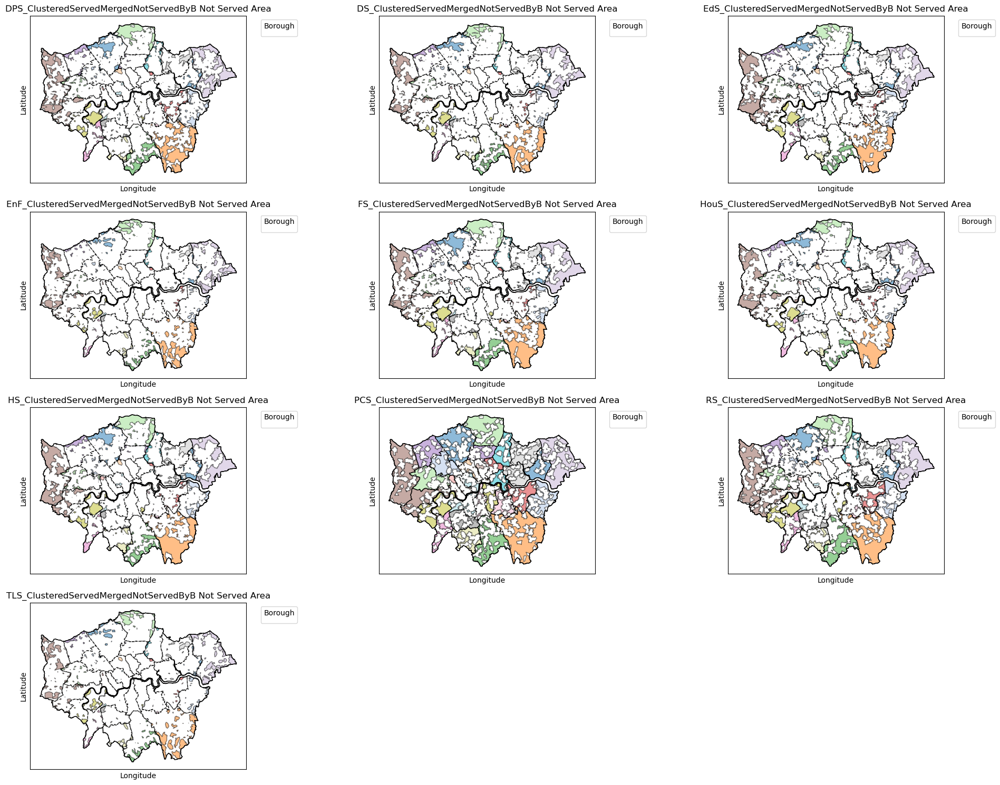

In [55]:
MergedNotServedByBGdfs = {}

for name, gdf in MergedNotServedGdfs.items():
    print(f"Processing {name} for Borough-based splitting...")

    combined_gdf = gpd.GeoDataFrame(columns=gdf.columns, crs=gdf.crs)

    for borough_index, borough_row in Borough.iterrows():
        borough_geom = borough_row.geometry
        borough_name = borough_row['NAME'] 
        
        clipped_gdf = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[borough_geom], crs=gdf.crs), how='intersection')
        
        if not clipped_gdf.empty:
            clipped_gdf['Borough'] = borough_name  
            combined_gdf = pd.concat([combined_gdf, clipped_gdf], ignore_index=True)

    combined_gdf['NotServedArea'] = combined_gdf['geometry'].area / 1e6

    new_name = name.replace("MergedNotServedWithinL", "MergedNotServedByB")
    MergedNotServedByBGdfs[new_name] = combined_gdf

    print(f"{new_name} GeoDataFrame combined with Boroughs.")
    print(f"Total area: {combined_gdf['geometry'].area.sum() / 1e6:.6f} square kilometers")
    print(f"Polygon count: {len(combined_gdf)}\n")


boroughs = Borough['NAME'].unique()
colors = plt.get_cmap('tab20', len(boroughs))
borough_color_map = {borough: colors(i) for i, borough in enumerate(sorted(boroughs))}

fig, axes = plt.subplots(4, 3, figsize=(20, 15))

axes = axes.flatten()

for idx, (name, gdf) in enumerate(MergedNotServedByBGdfs.items()):
    if idx < len(axes):
        ax = axes[idx]
        
        for borough_name, subset in gdf.groupby('Borough'):
            color = borough_color_map[borough_name]
            subset.plot(ax=ax, color=color, edgecolor='black', alpha=0.5, label=borough_name)
        
        for _, borough_row in Borough.iterrows():
            gpd.GeoSeries(borough_row.geometry).boundary.plot(ax=ax, color='black', linewidth=1, linestyle='--', alpha=0.7)
        
        LondonBoundary.boundary.plot(ax=ax, color='black', linewidth=1)
        
        ax.set_title(f"{name} Not Served Area")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        
        ax.set_xticks([])
        ax.set_yticks([])
        ax.legend(title='Borough', bbox_to_anchor=(1.05, 1), loc='upper left')

for idx in range(len(MergedNotServedByBGdfs), len(axes)):
    fig.delaxes(axes[idx])

plt.tight_layout()
plt.show()
# plt.savefig("MergedNotServedByBoroughAreas_3x4.png", dpi=300)

In [56]:
print("Keys in MergedNotServedByBGdfs:")
print(MergedNotServedByBGdfs.keys())

Keys in MergedNotServedByBGdfs:
dict_keys(['DPS_ClusteredServedMergedNotServedByB', 'DS_ClusteredServedMergedNotServedByB', 'EdS_ClusteredServedMergedNotServedByB', 'EnF_ClusteredServedMergedNotServedByB', 'FS_ClusteredServedMergedNotServedByB', 'HouS_ClusteredServedMergedNotServedByB', 'HS_ClusteredServedMergedNotServedByB', 'PCS_ClusteredServedMergedNotServedByB', 'RS_ClusteredServedMergedNotServedByB', 'TLS_ClusteredServedMergedNotServedByB'])


In [57]:
first_key = list(MergedNotServedByBGdfs.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
MergedNotServedByBGdfs[first_key]


First GeoDataFrame (DPS_ClusteredServedMergedNotServedByB):


,NAME,Area,geometry,Borough,NotServedArea
0,London,1573.400741,"MULTIPOLYGON (((521671.989 167222.235, 521674....",Kingston upon Thames,9.885659
1,London,1573.400741,"MULTIPOLYGON (((539512.400 160780.300, 539439....",Croydon,26.122348
2,London,1573.400741,"MULTIPOLYGON (((549828.300 169666.400, 549827....",Bromley,66.415413
3,London,1573.400741,"MULTIPOLYGON (((521496.480 177057.519, 521494....",Hounslow,9.477137
4,London,1573.400741,"MULTIPOLYGON (((519108.560 181781.773, 519108....",Ealing,4.747379
5,London,1573.400741,"MULTIPOLYGON (((555460.126 185823.884, 555449....",Havering,54.488380
6,London,1573.400741,"MULTIPOLYGON (((512079.189 182245.917, 512055....",Hillingdon,45.840650
7,London,1573.400741,"MULTIPOLYGON (((518562.098 192230.344, 518446....",Harrow,9.784877
8,London,1573.400741,"MULTIPOLYGON (((522645.043 185847.539, 522647....",Brent,2.405012
9,London,1573.400741,"MULTIPOLYGON (((528732.692 191762.238, 528729....",Barnet,19.692203


### 4.2.2 Population and Area Coverage Development Potential

In [58]:
BurdenOrPopulationCoverGdfs = {}

for name, gdf in Catchmentgdfs.items():
    print(f"Processing {name}...")

    burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')
    burden_gdf['RegionServiceArea_km2'] = burden_gdf['geometry'].area / 1e6
    burden_gdf['RegionServicePop'] = burden_gdf['RegionServiceArea_km2'] * burden_gdf['2024POPDEN']
    
    new_name = name.replace('ServedWithinL', 'BurdenORPopulationCover')
    

    BurdenOrPopulationCoverGdfs[new_name] = burden_gdf
    
    print(f"{new_name} GeoDataFrame created.")
    print(burden_gdf.info())  # 打印前几行以检查结果
    print("\n")
    # burden_gdf.to_file(f"{new_name}.shp")

print("Keys in BurdenOrPopulationCoverGdfs:")
print(BurdenOrPopulationCoverGdfs.keys())

first_key = list(BurdenOrPopulationCoverGdfs.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
BurdenOrPopulationCoverGdfs[first_key]

Processing DPS_ServingWithinL...


/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


DPS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 162914 entries, 0 to 162913
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               162914 non-null  int64   
 1   FacilityID             162914 non-null  int64   
 2   Name                   162914 non-null  object  
 3   FromBreak              162914 non-null  float64 
 4   ToBreak                162914 non-null  float64 
 5   LSOA11CD               162914 non-null  object  
 6   LSOA11NM               162914 non-null  object  
 7   MSOA11CD               162914 non-null  object  
 8   MSOA11NM               162914 non-null  object  
 9   LAD11CD                162914 non-null  object  
 10  LAD11NM                162914 non-null  object  
 11  RGN11CD                162914 non-null  object  
 12  RGN11NM                162914 non-null  object  
 13  LSOA2024               16

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


DS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 976260 entries, 0 to 976259
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               976260 non-null  int64   
 1   FacilityID             976260 non-null  int64   
 2   Name                   976260 non-null  object  
 3   FromBreak              976260 non-null  float64 
 4   ToBreak                976260 non-null  float64 
 5   LSOA11CD               976260 non-null  object  
 6   LSOA11NM               976260 non-null  object  
 7   MSOA11CD               976260 non-null  object  
 8   MSOA11NM               976260 non-null  object  
 9   LAD11CD                976260 non-null  object  
 10  LAD11NM                976260 non-null  object  
 11  RGN11CD                976260 non-null  object  
 12  RGN11NM                976260 non-null  object  
 13  LSOA2024               976

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


EdS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 87066 entries, 0 to 87065
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   ObjectID               87066 non-null  int64   
 1   FacilityID             87066 non-null  int64   
 2   Name                   87066 non-null  object  
 3   FromBreak              87066 non-null  float64 
 4   ToBreak                87066 non-null  float64 
 5   LSOA11CD               87066 non-null  object  
 6   LSOA11NM               87066 non-null  object  
 7   MSOA11CD               87066 non-null  object  
 8   MSOA11NM               87066 non-null  object  
 9   LAD11CD                87066 non-null  object  
 10  LAD11NM                87066 non-null  object  
 11  RGN11CD                87066 non-null  object  
 12  RGN11NM                87066 non-null  object  
 13  LSOA2024               87066 non-null  int

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


EnF_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 438998 entries, 0 to 438997
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               438998 non-null  int64   
 1   FacilityID             438998 non-null  int64   
 2   Name                   438998 non-null  object  
 3   FromBreak              438998 non-null  float64 
 4   ToBreak                438998 non-null  float64 
 5   LSOA11CD               438998 non-null  object  
 6   LSOA11NM               438998 non-null  object  
 7   MSOA11CD               438998 non-null  object  
 8   MSOA11NM               438998 non-null  object  
 9   LAD11CD                438998 non-null  object  
 10  LAD11NM                438998 non-null  object  
 11  RGN11CD                438998 non-null  object  
 12  RGN11NM                438998 non-null  object  
 13  LSOA2024               43

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


FS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 210372 entries, 0 to 210371
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               210372 non-null  int64   
 1   FacilityID             210372 non-null  int64   
 2   Name                   210372 non-null  object  
 3   FromBreak              210372 non-null  float64 
 4   ToBreak                210372 non-null  float64 
 5   LSOA11CD               210372 non-null  object  
 6   LSOA11NM               210372 non-null  object  
 7   MSOA11CD               210372 non-null  object  
 8   MSOA11NM               210372 non-null  object  
 9   LAD11CD                210372 non-null  object  
 10  LAD11NM                210372 non-null  object  
 11  RGN11CD                210372 non-null  object  
 12  RGN11NM                210372 non-null  object  
 13  LSOA2024               210

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


HouS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 171843 entries, 0 to 171842
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               171843 non-null  int64   
 1   FacilityID             171843 non-null  int64   
 2   Name                   171843 non-null  object  
 3   FromBreak              171843 non-null  float64 
 4   ToBreak                171843 non-null  float64 
 5   LSOA11CD               171843 non-null  object  
 6   LSOA11NM               171843 non-null  object  
 7   MSOA11CD               171843 non-null  object  
 8   MSOA11NM               171843 non-null  object  
 9   LAD11CD                171843 non-null  object  
 10  LAD11NM                171843 non-null  object  
 11  RGN11CD                171843 non-null  object  
 12  RGN11NM                171843 non-null  object  
 13  LSOA2024               1

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


HS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 174318 entries, 0 to 174317
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               174318 non-null  int64   
 1   FacilityID             174318 non-null  int64   
 2   Name                   174318 non-null  object  
 3   FromBreak              174318 non-null  float64 
 4   ToBreak                174318 non-null  float64 
 5   LSOA11CD               174318 non-null  object  
 6   LSOA11NM               174318 non-null  object  
 7   MSOA11CD               174318 non-null  object  
 8   MSOA11NM               174318 non-null  object  
 9   LAD11CD                174318 non-null  object  
 10  LAD11NM                174318 non-null  object  
 11  RGN11CD                174318 non-null  object  
 12  RGN11NM                174318 non-null  object  
 13  LSOA2024               174

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


PCS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 13453 entries, 0 to 13452
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   ObjectID               13453 non-null  int64   
 1   FacilityID             13453 non-null  int64   
 2   Name                   13453 non-null  object  
 3   FromBreak              13453 non-null  float64 
 4   ToBreak                13453 non-null  float64 
 5   Area_1                 13453 non-null  float64 
 6   LSOA11CD               13453 non-null  object  
 7   LSOA11NM               13453 non-null  object  
 8   MSOA11CD               13453 non-null  object  
 9   MSOA11NM               13453 non-null  object  
 10  LAD11CD                13453 non-null  object  
 11  LAD11NM                13453 non-null  object  
 12  RGN11CD                13453 non-null  object  
 13  RGN11NM                13453 non-null  obj

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


RS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 186163 entries, 0 to 186162
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               186163 non-null  int64   
 1   FacilityID             186163 non-null  int64   
 2   Name                   186163 non-null  object  
 3   FromBreak              186163 non-null  float64 
 4   ToBreak                186163 non-null  float64 
 5   LSOA11CD               186163 non-null  object  
 6   LSOA11NM               186163 non-null  object  
 7   MSOA11CD               186163 non-null  object  
 8   MSOA11NM               186163 non-null  object  
 9   LAD11CD                186163 non-null  object  
 10  LAD11NM                186163 non-null  object  
 11  RGN11CD                186163 non-null  object  
 12  RGN11NM                186163 non-null  object  
 13  LSOA2024               186

/tmp/ipykernel_20453/1913022026.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:27700
Right CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...

  burden_gdf = gpd.overlay(gdf, LSOA2024in11, how='intersection')


TLS_ServingWithinL GeoDataFrame created.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 445582 entries, 0 to 445581
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   ObjectID               445582 non-null  int64   
 1   FacilityID             445582 non-null  int64   
 2   Name                   445582 non-null  object  
 3   FromBreak              445582 non-null  float64 
 4   ToBreak                445582 non-null  float64 
 5   LSOA11CD               445582 non-null  object  
 6   LSOA11NM               445582 non-null  object  
 7   MSOA11CD               445582 non-null  object  
 8   MSOA11NM               445582 non-null  object  
 9   LAD11CD                445582 non-null  object  
 10  LAD11NM                445582 non-null  object  
 11  RGN11CD                445582 non-null  object  
 12  RGN11NM                445582 non-null  object  
 13  LSOA2024               44

,ObjectID,FacilityID,Name,FromBreak,ToBreak,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,LSOA2024,Area,2024POPDEN,geometry,RegionServiceArea_km2,RegionServicePop
0,9700,9700,Omniweb : 0 - 1000,0.0,1000.0,E01000654,Bromley 039A,E02000165,Bromley 039,E09000006,Bromley,E12000007,London,1276,1.056008,1208.323682,"POLYGON ((540973.990 157066.526, 540968.134 15...",0.029692,35.877160
1,5074,5074,Orpington Saab Ltd : 0 - 1000,0.0,1000.0,E01000654,Bromley 039A,E02000165,Bromley 039,E09000006,Bromley,E12000007,London,1276,1.056008,1208.323682,"POLYGON ((540884.059 156953.514, 540988.661 15...",0.038662,46.716735
2,5099,5099,Tatsfield Garage : 0 - 1000,0.0,1000.0,E01000654,Bromley 039A,E02000165,Bromley 039,E09000006,Bromley,E12000007,London,1276,1.056008,1208.323682,"POLYGON ((540884.059 156953.514, 540988.661 15...",0.038662,46.716735
3,5089,5089,Paul Watson Services : 0 - 1000,0.0,1000.0,E01000654,Bromley 039A,E02000165,Bromley 039,E09000006,Bromley,E12000007,London,1276,1.056008,1208.323682,"POLYGON ((540940.399 156898.573, 540938.300 15...",0.010661,12.882467
4,4133,4133,Sunningvale Service Station Ltd : 0 - 1000,0.0,1000.0,E01000654,Bromley 039A,E02000165,Bromley 039,E09000006,Bromley,E12000007,London,1276,1.056008,1208.323682,"POLYGON ((541716.500 158356.100, 541682.000 15...",0.263422,318.299007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162909,2953,2953,Kmax MOT : 0 - 1000,0.0,1000.0,E01000247,Barnet 002C,E02000025,Barnet 002,E09000003,Barnet,E12000007,London,1693,0.267823,6321.347879,"POLYGON ((525874.229 196972.183, 525878.872 19...",0.242852,1535.151754
162910,2339,2339,K Max Ltd : 0 - 1000,0.0,1000.0,E01000247,Barnet 002C,E02000025,Barnet 002,E09000003,Barnet,E12000007,London,1693,0.267823,6321.347879,"POLYGON ((525874.229 196972.183, 525878.872 19...",0.242852,1535.151754
162911,2879,2879,Mask : 0 - 1000,0.0,1000.0,E01000247,Barnet 002C,E02000025,Barnet 002,E09000003,Barnet,E12000007,London,1693,0.267823,6321.347879,"POLYGON ((525871.593 196971.906, 525876.546 19...",0.241859,1528.873050
162912,7347,7347,Get Top Listing : 0 - 1000,0.0,1000.0,E01000247,Barnet 002C,E02000025,Barnet 002,E09000003,Barnet,E12000007,London,1693,0.267823,6321.347879,"MULTIPOLYGON (((526117.799 196618.466, 526109....",0.204364,1291.857686


In [59]:

PopulationCoveragePotentials = {}

for name, gdf in BurdenOrPopulationCoverGdfs.items():
    print(f"Processing {name}...")

    aggregated_data = gdf.groupby(['LSOA11CD', 'LSOA11NM'])['RegionServicePop'].sum().reset_index()
    potential_gdf = LSOA2024in11.merge(aggregated_data, on=['LSOA11CD', 'LSOA11NM'], how='left')
    potential_gdf['PopPotential'] = 1 - (potential_gdf['RegionServicePop'] / potential_gdf['LSOA2024'])


    new_name = name.replace('ServingWithinL', 'PopulationCoveragePotentials')
    PopulationCoveragePotentials[new_name] = potential_gdf


    print(f"{new_name} created with {len(potential_gdf)} rows.")
    potential_gdf.info()  
    print("\n")

print("\nKeys in PopulationCoveragePotentials:")
print(PopulationCoveragePotentials.keys())


first_key = list(PopulationCoveragePotentials.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
PopulationCoveragePotentials[first_key]

Processing DPS_ServingWithinL...
DPS_PopulationCoveragePotentials created with 4835 rows.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   LSOA11CD          4835 non-null   object  
 1   LSOA11NM          4835 non-null   object  
 2   MSOA11CD          4835 non-null   object  
 3   MSOA11NM          4835 non-null   object  
 4   LAD11CD           4835 non-null   object  
 5   LAD11NM           4835 non-null   object  
 6   RGN11CD           4835 non-null   object  
 7   RGN11NM           4835 non-null   object  
 8   geometry          4835 non-null   geometry
 9   LSOA2024          4835 non-null   int64   
 10  Area              4835 non-null   float64 
 11  2024POPDEN        4835 non-null   float64 
 12  RegionServicePop  4834 non-null   float64 
 13  PopPotential      4834 non-null   float64 
dtypes: float64(4), geometr

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,geometry,LSOA2024,Area,2024POPDEN,RegionServicePop,PopPotential
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532105.092 182011.230, 532162.491 18...",2158,0.133321,16186.525314,343939.737462,-158.378933
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532746.813 181786.891, 532671.688 18...",2016,0.226191,8912.810705,338162.068778,-166.739121
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532135.145 182198.119, 532158.250 18...",2289,0.057303,39945.575922,364302.920039,-158.153744
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((533807.946 180767.770, 533649.063 18...",2012,0.190739,10548.459027,314554.818329,-155.339373
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,"POLYGON ((545122.049 184314.931, 545271.917 18...",1871,0.144196,12975.408382,14840.119415,-6.931651
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544642.680 179824.674, 544766.313 17...",1387,0.123309,11248.148255,1332.785538,0.039088
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546579.195 181097.813, 546687.036 18...",1973,1.004853,1963.471103,2848.768030,-0.443876
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544536.486 179447.115, 544602.630 17...",1802,0.152262,11834.864110,11259.021684,-5.248070
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546415.745 180152.270, 546320.715 18...",1709,0.558478,3060.104266,11707.933611,-5.850751


In [60]:
AreaCoveragePotential = {}

for name, gdf in MergedServedAreaByLSOA.items():
    print(f"Processing {name}...")

    columns_to_keep = ['LSOA11CD', 'LSOA11NM', 'LSOAServedArea', 'CoverPotential']
    gdf_subset = gdf[columns_to_keep]

    merged_gdf = LSOA2024in11.merge(gdf_subset, on=['LSOA11CD', 'LSOA11NM'], how='left')
    new_name = name.replace('MergedServedAreaByLSOA', 'AreaCoveragePotential')
    AreaCoveragePotential[new_name] = merged_gdf
    print(f"{new_name} created with {len(merged_gdf)} rows.")
    print(merged_gdf.info())  
    print("\n")

print("\nKeys in AreaCoveragePotential:")
print(AreaCoveragePotential.keys())

first_key = list(AreaCoveragePotential.keys())[0]
print(f"\nFirst GeoDataFrame ({first_key}):")
AreaCoveragePotential[first_key]

Processing DPS_ClusteredServed...
DPS_ClusteredServed created with 4835 rows.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   LSOA11CD        4835 non-null   object  
 1   LSOA11NM        4835 non-null   object  
 2   MSOA11CD        4835 non-null   object  
 3   MSOA11NM        4835 non-null   object  
 4   LAD11CD         4835 non-null   object  
 5   LAD11NM         4835 non-null   object  
 6   RGN11CD         4835 non-null   object  
 7   RGN11NM         4835 non-null   object  
 8   geometry        4835 non-null   geometry
 9   LSOA2024        4835 non-null   int64   
 10  Area            4835 non-null   float64 
 11  2024POPDEN      4835 non-null   float64 
 12  LSOAServedArea  4834 non-null   float64 
 13  CoverPotential  4834 non-null   float64 
dtypes: float64(4), geometry(1), int64(1), object(8)
memory usage: 529.

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,geometry,LSOA2024,Area,2024POPDEN,LSOAServedArea,CoverPotential
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532105.092 182011.230, 532162.491 18...",2158,0.133321,16186.525314,0.133321,0.000000e+00
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532746.813 181786.891, 532671.688 18...",2016,0.226191,8912.810705,0.226191,0.000000e+00
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((532135.145 182198.119, 532158.250 18...",2289,0.057303,39945.575922,0.057303,1.110223e-16
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,"POLYGON ((533807.946 180767.770, 533649.063 18...",2012,0.190739,10548.459027,0.190739,1.110223e-16
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,"POLYGON ((545122.049 184314.931, 545271.917 18...",1871,0.144196,12975.408382,0.144196,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544642.680 179824.674, 544766.313 17...",1387,0.123309,11248.148255,0.050567,5.899165e-01
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546579.195 181097.813, 546687.036 18...",1973,1.004853,1963.471103,0.313799,6.877165e-01
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,"POLYGON ((544536.486 179447.115, 544602.630 17...",1802,0.152262,11834.864110,0.145900,4.178242e-02
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,"POLYGON ((546415.745 180152.270, 546320.715 18...",1709,0.558478,3060.104266,0.539851,3.335275e-02


In [62]:
Potential = {}

# Iterate over each GeoDataFrame in AreaCoveragePotential
for area_name, area_gdf in AreaCoveragePotential.items():
    base_name = area_name.split('_')[0]
    pop_name = f"{base_name}_PopulationCoveragePotentials"

    # Check if the corresponding GeoDataFrame exists in PopulationCoveragePotentials
    if pop_name in PopulationCoveragePotentials:
        pop_gdf = PopulationCoveragePotentials[pop_name]
        merged_gdf = area_gdf.merge(pop_gdf[['LSOA11CD', 'RegionServicePop', 'PopPotential']], on='LSOA11CD', how='left')
        new_name = f"{base_name}_Potential"
        Potential[new_name] = merged_gdf

        print(f"{new_name} GeoDataFrame created with {len(merged_gdf)} rows.")
        merged_gdf.info()
        print("\n")
    else:
        print(f"Warning: No corresponding PopulationCoveragePotentials GeoDataFrame found for {base_name}.")

# Print the keys in the Potential dictionary
print("\nKeys in Potential:")
print(Potential.keys())

# Check if the Potential dictionary is empty
if not Potential:
    print("The Potential dictionary is empty, no GeoDataFrame to process.")
else:
    print(f"The Potential dictionary contains the following keys: {list(Potential.keys())}")

# Iterate over each GeoDataFrame in the Potential dictionary
for name, gdf in Potential.items():
    print(f"Processing {name}...")

    # Check if the required columns exist
    if 'PopPotential' not in gdf.columns or 'CoverPotential' not in gdf.columns:
        print(f"Warning: {name} is missing 'PopPotential' or 'CoverPotential' columns, skipping this GeoDataFrame.")
        continue

    pop_max = gdf['PopPotential'].max()
    pop_min = gdf['PopPotential'].min()

    cover_max = gdf['CoverPotential'].max()
    cover_min = gdf['CoverPotential'].min()

    print(f"PopPotential maximum value: {pop_max}")
    print(f"PopPotential minimum value: {pop_min}")
    print(f"CoverPotential maximum value: {cover_max}")
    print(f"CoverPotential minimum value: {cover_min}")

    pop_max_row = gdf.loc[gdf['PopPotential'].idxmax()]
    pop_min_row = gdf.loc[gdf['PopPotential'].idxmin()]

    cover_max_row = gdf.loc[gdf['CoverPotential'].idxmax()]
    cover_min_row = gdf.loc[gdf['CoverPotential'].idxmin()]

    print(f"\nRow with maximum PopPotential:\n{pop_max_row}")
    print(f"\nRow with minimum PopPotential:\n{pop_min_row}")
    print(f"\nRow with maximum CoverPotential:\n{cover_max_row}")
    print(f"\nRow with minimum CoverPotential:\n{cover_min_row}")
    print("\n" + "="*50 + "\n")

DPS_Potential GeoDataFrame created with 4835 rows.
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   LSOA11CD          4835 non-null   object  
 1   LSOA11NM          4835 non-null   object  
 2   MSOA11CD          4835 non-null   object  
 3   MSOA11NM          4835 non-null   object  
 4   LAD11CD           4835 non-null   object  
 5   LAD11NM           4835 non-null   object  
 6   RGN11CD           4835 non-null   object  
 7   RGN11NM           4835 non-null   object  
 8   geometry          4835 non-null   geometry
 9   LSOA2024          4835 non-null   int64   
 10  Area              4835 non-null   float64 
 11  2024POPDEN        4835 non-null   float64 
 12  LSOAServedArea    4834 non-null   float64 
 13  CoverPotential    4834 non-null   float64 
 14  RegionServicePop  4834 non-null   float64 
 15  PopPotential 

Processing DPS_Potential...
Saved plot as DPS_Potential_Potential.png


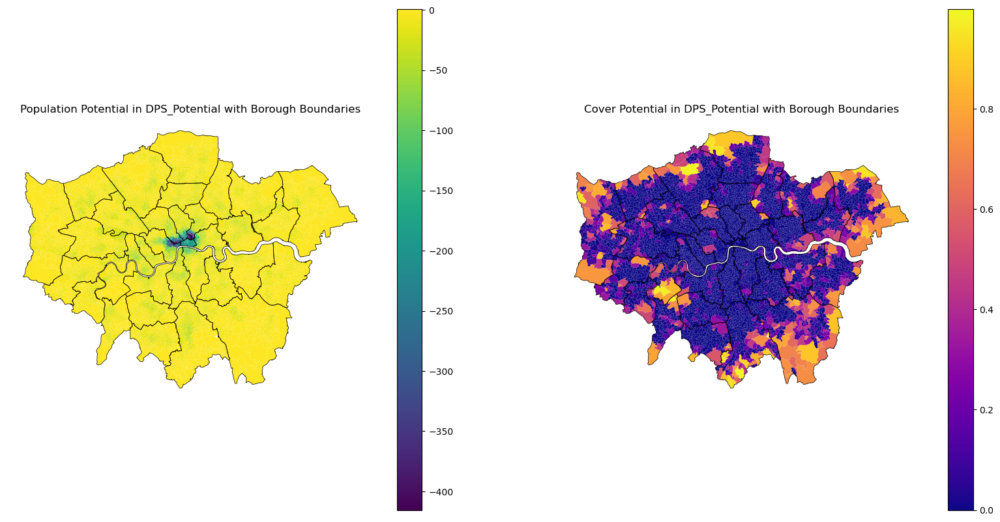

Processing DS_Potential...
Saved plot as DS_Potential_Potential.png


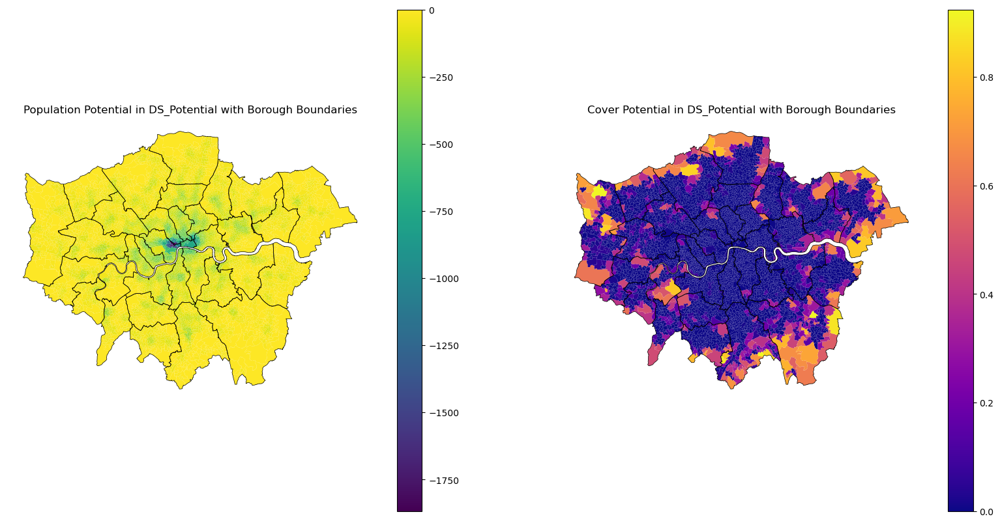

Processing EdS_Potential...
Saved plot as EdS_Potential_Potential.png


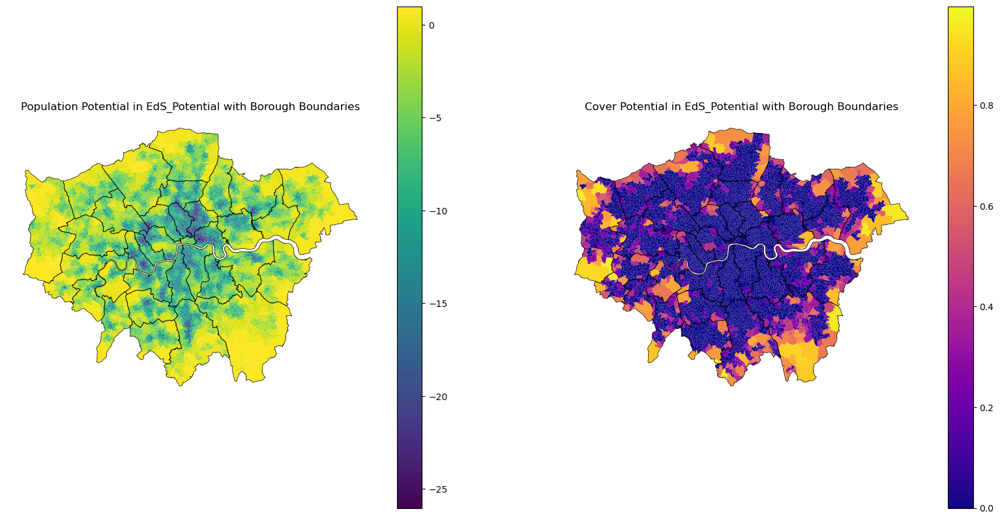

Processing EnF_Potential...
Saved plot as EnF_Potential_Potential.png


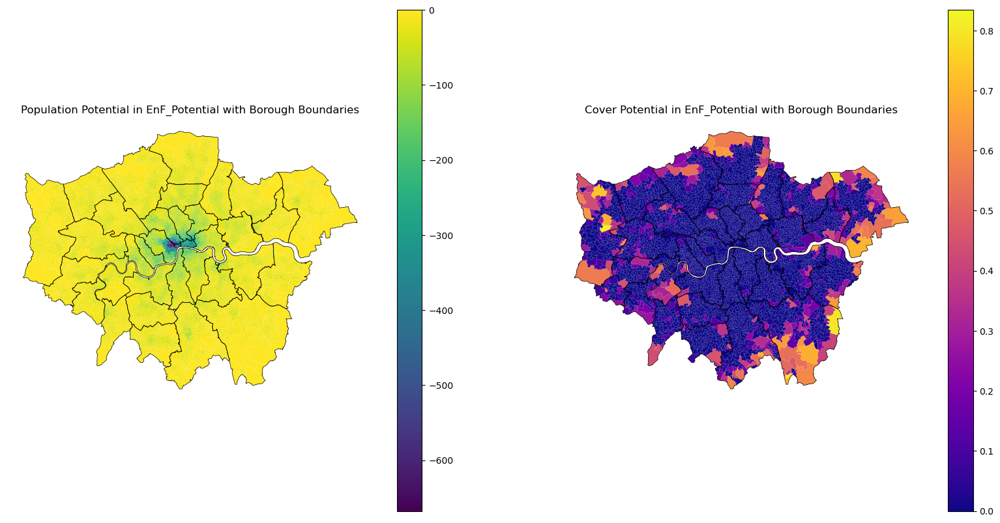

Processing FS_Potential...
Saved plot as FS_Potential_Potential.png


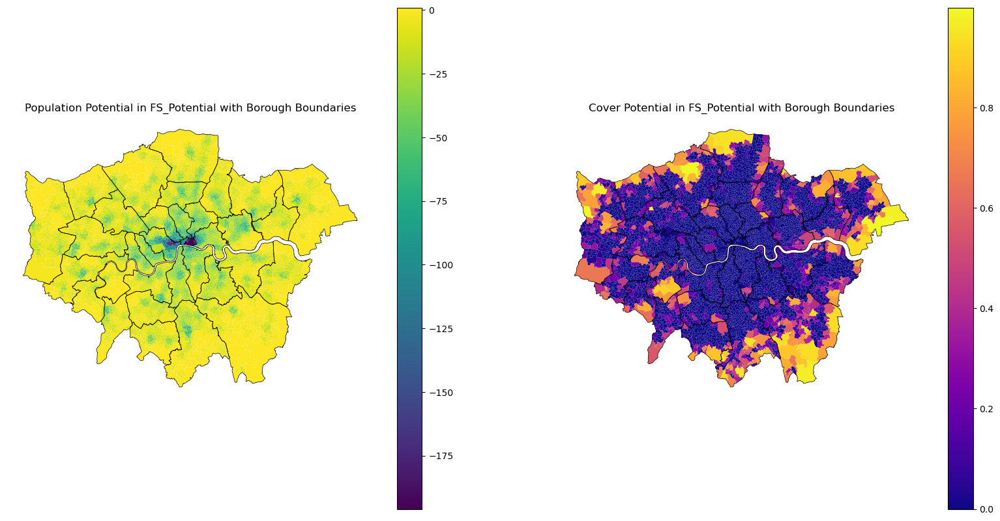

Processing HouS_Potential...
Saved plot as HouS_Potential_Potential.png


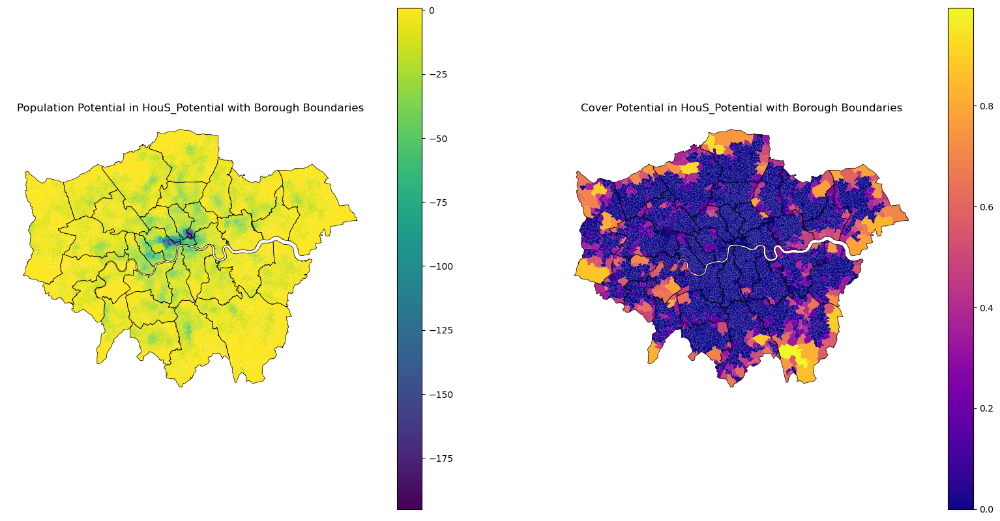

Processing HS_Potential...
Saved plot as HS_Potential_Potential.png


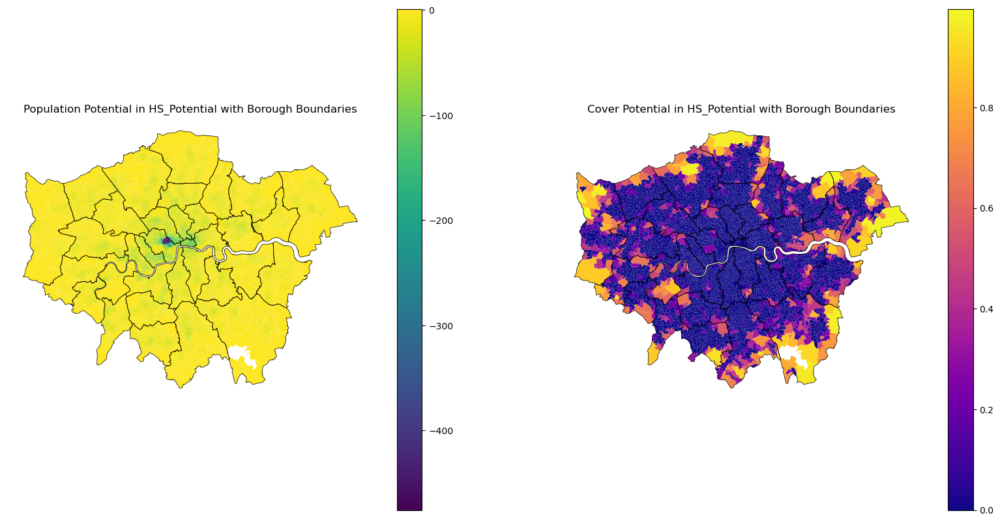

Processing PCS_Potential...
Saved plot as PCS_Potential_Potential.png


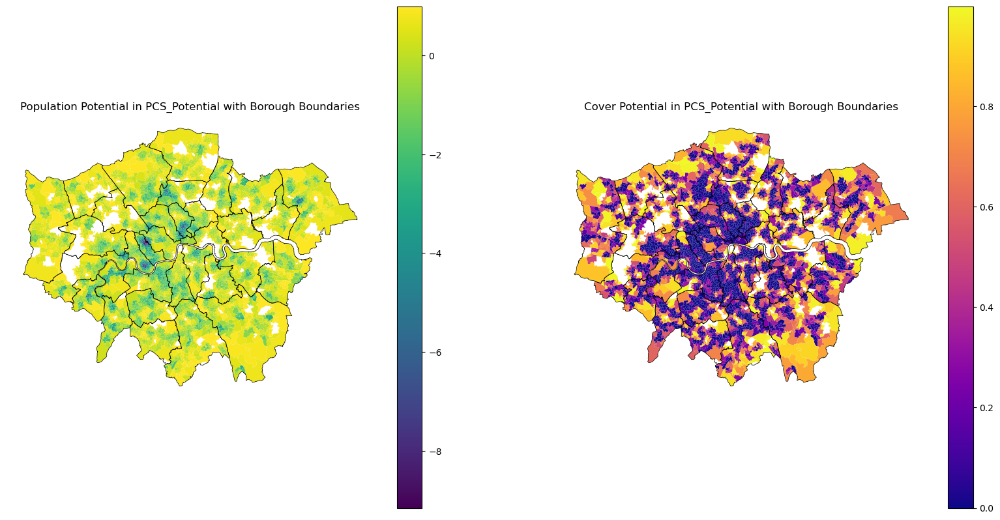

Processing RS_Potential...
Saved plot as RS_Potential_Potential.png


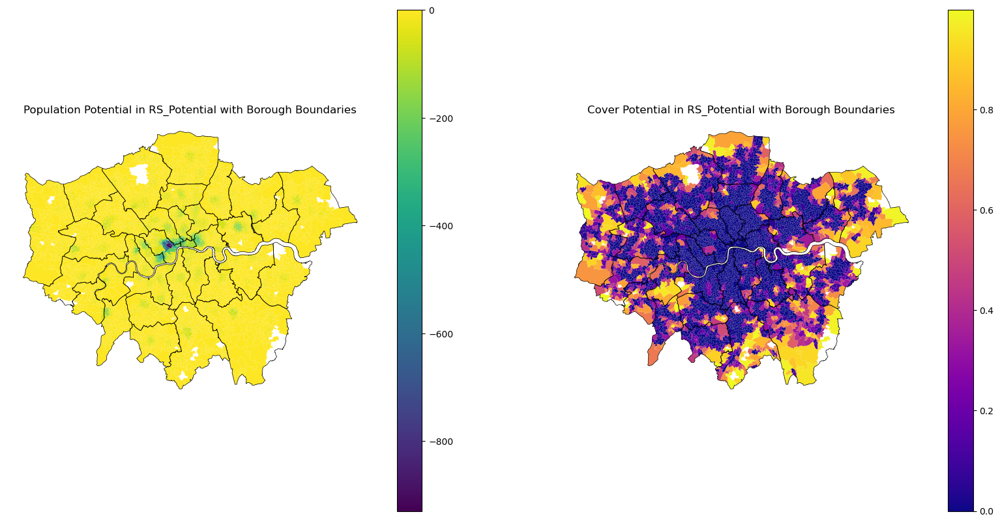

Processing TLS_Potential...
Saved plot as TLS_Potential_Potential.png


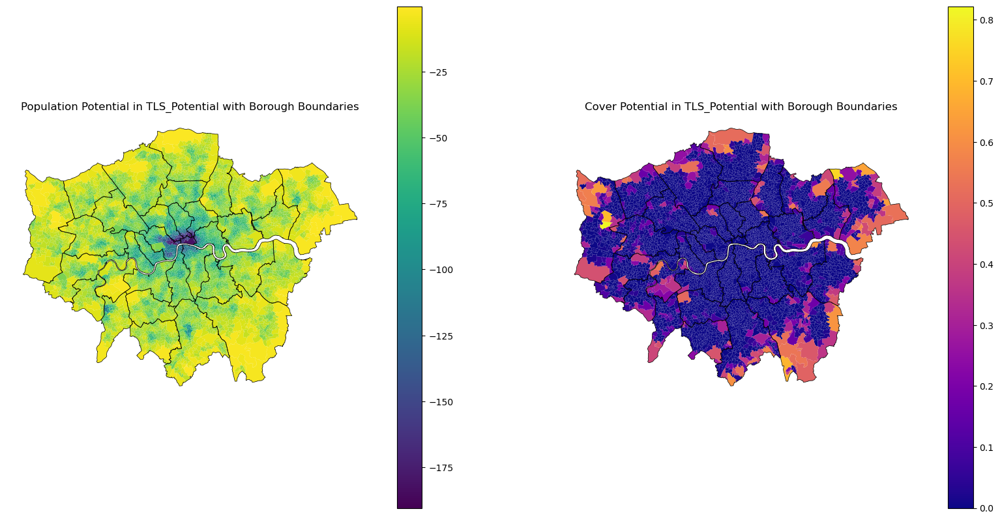

In [63]:
for name, gdf in Potential.items():
    print(f"Processing {name}...")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

    gdf.plot(column='PopPotential', cmap='viridis', legend=True, ax=ax1)
    Borough.boundary.plot(ax=ax1, color='black', linewidth=0.5)
    ax1.set_title(f"Population Potential in {name} with Borough Boundaries")
    ax1.set_axis_off()

    gdf.plot(column='CoverPotential', cmap='plasma', legend=True, ax=ax2)
    Borough.boundary.plot(ax=ax2, color='black', linewidth=0.5)
    ax2.set_title(f"Cover Potential in {name} with Borough Boundaries")
    ax2.set_axis_off()


    output_filename = f"{name}_Potential.png"
    plt.savefig(output_filename, dpi=300, bbox_inches='tight')
    print(f"Saved plot as {output_filename}")

   
    plt.show()
    plt.close(fig)

# 5 Discussion

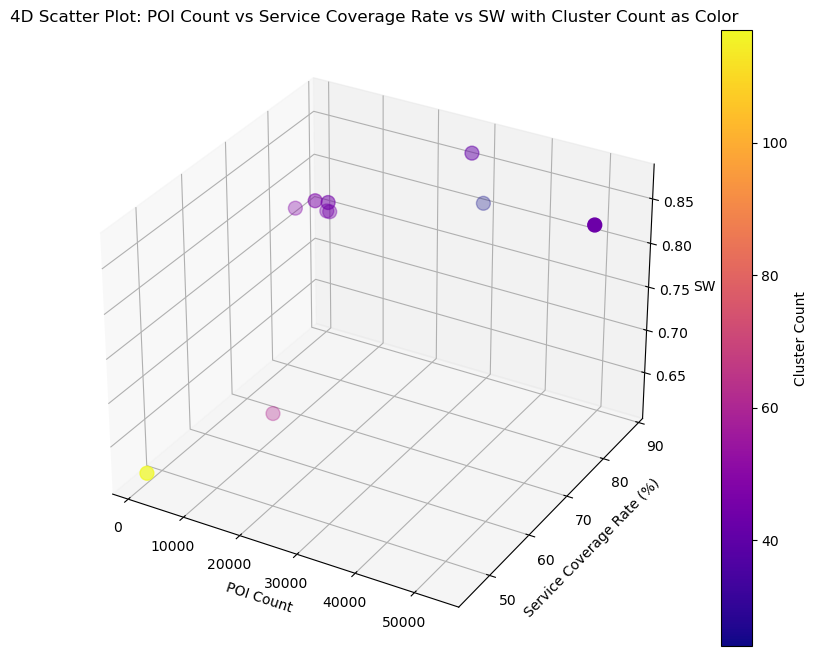

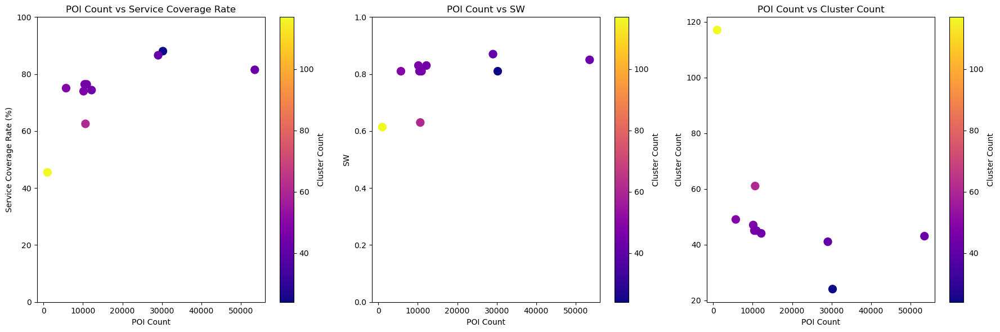

In [64]:
data = {
    'Label': ['DPS', 'HS', 'HouS', 'RS', 'EdS', 'TLS', 'FS', 'DS', 'EnF', 'PCS'],
    'POI Count': [10419, 10144, 10944, 10625, 5717, 30244, 12173, 53525, 29043, 996],
    'Service Coverage Rate': [76.40, 73.98, 76.40, 62.54, 75.06, 88.04, 74.38, 81.50, 86.60, 45.51],
    'SW': [0.81, 0.83, 0.81, 0.63, 0.81, 0.81, 0.83, 0.85, 0.87, 0.614],
    'Cluster Count': [45, 47, 45, 61, 49, 24, 44, 43, 41, 117]
}
df = pd.DataFrame(data)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

sc = ax.scatter(df['POI Count'], df['Service Coverage Rate'], df['SW'], c=df['Cluster Count'], cmap='plasma', s=100)
ax.set_xlabel('POI Count')
ax.set_ylabel('Service Coverage Rate (%)')
ax.set_zlabel('SW')

cbar = plt.colorbar(sc)
cbar.set_label('Cluster Count')

plt.title('4D Scatter Plot: POI Count vs Service Coverage Rate vs SW with Cluster Count as Color')
plt.savefig('Relationship_4D.png')
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# POI Count vs Service Coverage Rate
scatter1 = axs[0].scatter(df['POI Count'], df['Service Coverage Rate'], c=df['Cluster Count'], cmap='plasma', s=100)
axs[0].set_title('POI Count vs Service Coverage Rate')
axs[0].set_xlabel('POI Count')
axs[0].set_ylabel('Service Coverage Rate (%)')
axs[0].set_ylim(0, 100)  
cbar1 = plt.colorbar(scatter1, ax=axs[0])
cbar1.set_label('Cluster Count')


scatter2 = axs[1].scatter(df['POI Count'], df['SW'], c=df['Cluster Count'], cmap='plasma', s=100)
axs[1].set_title('POI Count vs SW')
axs[1].set_xlabel('POI Count')
axs[1].set_ylabel('SW')
axs[1].set_ylim(0, 1) 
cbar2 = plt.colorbar(scatter2, ax=axs[1])
cbar2.set_label('Cluster Count')


scatter3 = axs[2].scatter(df['POI Count'], df['Cluster Count'], c=df['Cluster Count'], cmap='plasma', s=100)
axs[2].set_title('POI Count vs Cluster Count')
axs[2].set_xlabel('POI Count')
axs[2].set_ylabel('Cluster Count')
cbar3 = plt.colorbar(scatter3, ax=axs[2])
cbar3.set_label('Cluster Count')


plt.tight_layout()
plt.savefig('Relationship_2D.png')
plt.show()

# Appendix

## Batch export PSD layers

In [71]:
from psd_tools import PSDImage

psd = PSDImage.open('Hierarchical Tree.psd')

# Function to export a layer if it's visible
def export_layer(layer):
    if layer.is_visible():
        image = layer.composite()
        file_name = f"{layer.name}.png"
        try:
            image.save(file_name)
            print(f"Saved: {file_name}")
        except Exception as e:
            print(f"Error saving {file_name}: {e}")

for layer in psd:
    if layer.is_group():
        for child_layer in layer:
            print(f"Processing group layer: {child_layer.name}")
            export_layer(child_layer)
    else:
        print(f"Processing non-group layer: {layer.name}")
        export_layer(layer)

Processing non-group layer: RS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea
Saved: RS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea.png
Processing non-group layer: TLS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea
Saved: TLS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea.png
Processing non-group layer: DPS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea
Saved: DPS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea.png
Processing non-group layer: DS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea
Saved: DS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea.png
Processing non-group layer: EdS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea
Saved: EdS_DivideClustersbyDistrict_Hierarchical_Network_Diagram_with_ServiceArea.png
Processing non-group layer: EnF_DivideClustersbyDistrict_Hi

## Word count

In [ ]:
pdf_file_path = "Dissertation_Template (21).pdf"
pdf_file = open(pdf_file_path, "rb")
pdf_reader = PyPDF2.PdfReader(pdf_file)

start_page = 13 
end_page = 83 

text = ""
for page_num in range(start_page, end_page + 1):
    page = pdf_reader.pages[page_num]
    text += page.extract_text()

pdf_file.close()

word_count = len(text.split())
print(f"Word count: {word_count}")

In [ ]:
pdf_file_path = "Dissertation_Template (21).pdf"
pdf_file = open(pdf_file_path, "rb")
pdf_reader = PyPDF2.PdfReader(pdf_file)


start_page = 13 
end_page = 83  

text = ""
for page_num in range(start_page, end_page + 1):
    page = pdf_reader.pages[page_num]
    page_text = page.extract_text()

    page_text = re.sub(r'(Table\s+\d+[:]?.*?\n)', '', page_text, flags=re.IGNORECASE) 
    page_text = re.sub(r'(Figure\s+\d+[:]?.*?\n)', '', page_text, flags=re.IGNORECASE)  
    page_text = re.sub(r'(\bFigure\b|\bTable\b).*?(\n|\r\n|\r)', '', page_text, flags=re.IGNORECASE)  
    
    text += page_text

pdf_file.close()

filtered_text = " ".join(text.split())
word_count = len(filtered_text.split())
print(f"Word count: {word_count}")

In [ ]:
end_time = time.time()
run_time = end_time - start_time
print("Total run time: ", run_time, "seconds")